In [1]:
import os
import cv2
import math
import shutil
import random
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
import keras_tuner as kt
import matplotlib.pyplot as plt
from PIL import Image, ImageEnhance
from sklearn.utils import class_weight
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing import image
from tensorflow.keras.layers import Input, Lambda
from tensorflow.keras.models import load_model, Sequential, Model
from sklearn.metrics import confusion_matrix, classification_report
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, GlobalAveragePooling2D
from sklearn.metrics import roc_curve, classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, mean_squared_error 

## **Exploratory Data Analysis (EDA)**
Before training, we analyzed the dataset to understand its characteristics:

- **Class Distribution**: Checking the number of images per class after splitting.
- **Visual Inspection**: Reviewing a few preprocessed images to confirm the effectiveness of preprocessing steps.

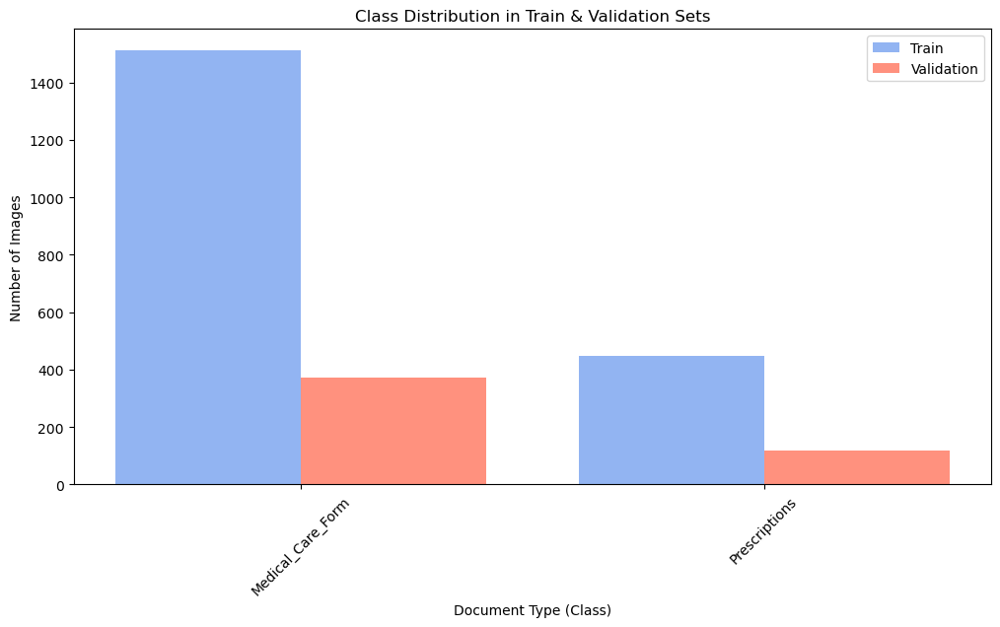

In [2]:
train_dir = "train_dataset"
test_dir = "validation_dataset"

def get_class_distribution(base_dir):
    class_counts = {}
    for class_name in os.listdir(base_dir):
        class_path = os.path.join(base_dir, class_name)
        if os.path.isdir(class_path):
            clean_name = class_name.replace("Processed_", "")
            class_counts[clean_name] = len(os.listdir(class_path))
    return class_counts

train_distribution = get_class_distribution(train_dir)
test_distribution = get_class_distribution(test_dir)

classes = sorted(set(train_distribution.keys()).union(set(test_distribution.keys())))
train_values = [train_distribution.get(cls, 0) for cls in classes]
test_values = [test_distribution.get(cls, 0) for cls in classes]

plt.figure(figsize=(12, 6))
bar_width = 0.4
x_indexes = range(len(classes))

plt.bar([i - bar_width / 2 for i in x_indexes], train_values, width=bar_width, color='cornflowerblue', label="Train", alpha=0.7)
plt.bar([i + bar_width / 2 for i in x_indexes], test_values, width=bar_width, color='tomato', label="Validation", alpha=0.7)

# Labels
plt.xlabel("Document Type (Class)")
plt.ylabel("Number of Images")
plt.title("Class Distribution in Train & Validation Sets")
plt.xticks(ticks=x_indexes, labels=classes, rotation=45)
plt.legend()
plt.show()

## **Data Augmentation for the Training Dataset**  

To enhance the diversity and robustness of our training dataset, we applied various **data augmentation techniques**. This helps the model generalize better, preventing overfitting and improving performance on unseen data.

### **Augmentation Techniques Applied**  

1. **Lighting Adjustment**:  
   We randomly adjust the **brightness** and **contrast** of the images to simulate different lighting conditions, ensuring the model becomes more robust to varying lighting during training.

2. **Gaussian Blur**:  
   A **Gaussian blur** was applied randomly to simulate different levels of image clarity and noise, helping the model adapt to blurry or lower-quality scans.

3. **Handshake Blur**:  
   A custom **handshake blur** is used to simulate low-resolution images or distortions that might be encountered during document scanning.

4. **Rotation**:  
   Random **rotation** of images by up to 30 degrees ensures that the model can handle documents that may be tilted or scanned at an angle.

These augmentations were applied selectively to the training images, enhancing the model's ability to learn from more diverse data. 

The **validation set** was not augmented to preserve a consistent evaluation standard.

#### **Data Generators for Training and Validation**  

We used the **ImageDataGenerator** class from Keras to automate and efficiently apply the augmentations.  

- **Training Set Augmentation**:  
   The images are resized to **256x256 pixels**, and augmentation techniques like rotation, brightness adjustment, and custom preprocessing are applied in real-time during model training. The images are also normalized to the range [0, 1].

- **Validation Set**:  
   The validation images are resized to **256x256 pixels** and rescaled to the range [0, 1] without any augmentation, ensuring we evaluate the model on unaltered data.

By applying these augmentations, we ensure that our model is exposed to a wide range of variations, improving its generalization and ability to classify medical documents more accurately.


In [3]:
#augment the train dataset 
def adjust_lighting(image):
    pil_image = Image.fromarray(image)
    brightness_factor = random.uniform(0.7, 1.0)
    contrast_factor = random.uniform(0.7, 1.0)

    enhancer = ImageEnhance.Brightness(pil_image)
    pil_image = enhancer.enhance(brightness_factor)

    enhancer = ImageEnhance.Contrast(pil_image)
    pil_image = enhancer.enhance(contrast_factor)

    return np.array(pil_image)

def add_gaussian_blur(img):
    return cv2.GaussianBlur(img, (3, 3), 0)

def add_handshake_blur(img, kernel_size=2):
    kernel = np.zeros((kernel_size, kernel_size))
    kernel[int((kernel_size - 1)/2), :] = np.ones(kernel_size)
    kernel = kernel / kernel_size
    return cv2.filter2D(img, -1, kernel)

def rotate_image(img, angle=30):
    h, w = img.shape[:2]
    center = (w // 2, h // 2)
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)
    return cv2.warpAffine(img, rotation_matrix, (w, h), borderMode=cv2.BORDER_REPLICATE)

def custom_preprocessing(img):
    img = img_to_array(img).astype(np.uint8)

    img = adjust_lighting(img)

    if random.random() > 0.8:
        img = add_gaussian_blur(img)
    elif random.random() > 0.8:
        img = add_handshake_blur(img)

    if random.random() > 0.5:
        angle = random.uniform(-30, 30)
        img = rotate_image(img, angle)
    
    img = img.astype(np.float32) / 255.0
    return img


train_dir = r"train_dataset"
val_dir = r"validation_dataset"  
input_dir = r"preprocessed_dataset"


train_datagen = ImageDataGenerator(
    rotation_range=30,
    brightness_range=[0.98, 1.02],
    preprocessing_function=custom_preprocessing 
)

val_datagen = ImageDataGenerator(rescale=1.0 / 255.0)  

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(256, 256),
    batch_size=32,
    class_mode='binary'
)

validation_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size=(256, 256),
    batch_size=32,
    class_mode='binary',
    shuffle=False  
)


Found 1959 images belonging to 2 classes.
Found 490 images belonging to 2 classes.


## Now, let's display some examples of the **augmented data** to visualize the variations introduced through data augmentation.

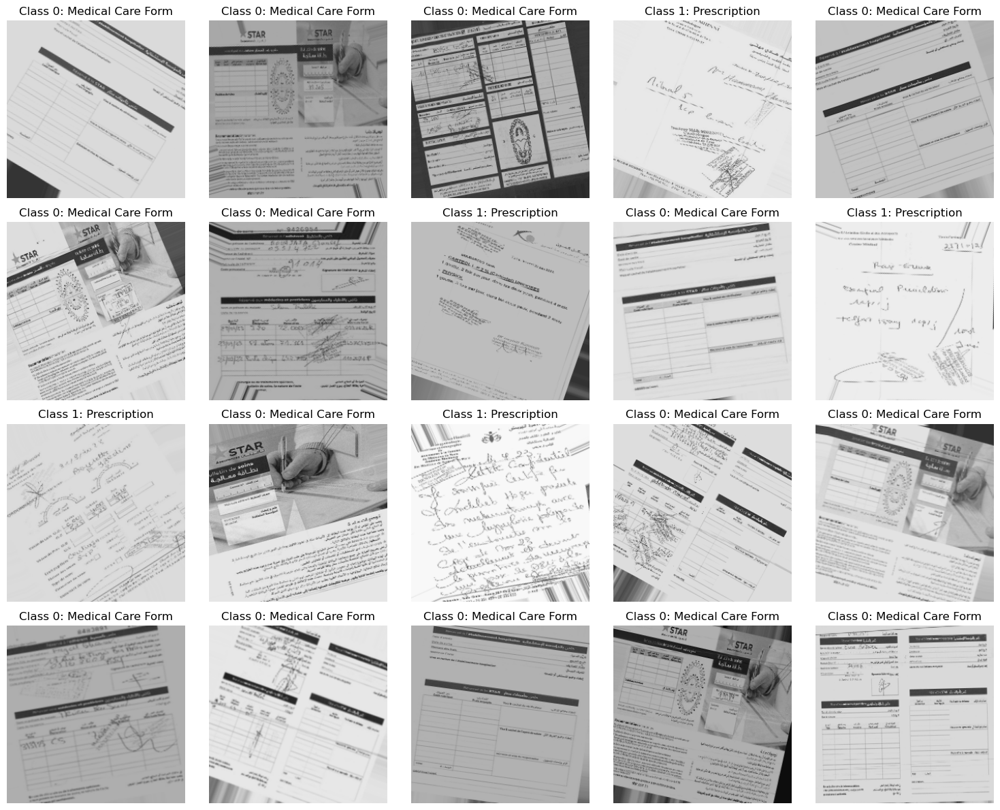

In [4]:
class_names = {0: "Medical Care Form", 1: "Prescription"}

batch = next(train_generator)
images, labels = batch
num_images = min(20, len(images))  

fig, axes = plt.subplots(4, 5, figsize=(15, 12))
axes = axes.ravel()

for i in range(num_images):
    axes[i].imshow((images[i] * 255).astype(np.uint8)) 
    axes[i].axis('off')

    class_label = np.argmax(labels[i]) if labels.ndim > 1 else int(labels[i])

    class_name = class_names[class_label]

    axes[i].set_title(f"Class {class_label}: {class_name}")

plt.tight_layout()
plt.show()


In [5]:
labels = train_generator.classes

unique_classes, class_counts = np.unique(labels, return_counts=True)
print("Class distribution:")
for cls, count in zip(unique_classes, class_counts):
    print(f"Class {cls}: {count} samples")

class_weights = class_weight.compute_class_weight(
    'balanced', classes=np.unique(labels), y=labels
)
class_weights = dict(enumerate(class_weights))

print("Class weights:")
for cls, weight in class_weights.items():
    print(f"Class {cls}: {weight:.2f}")

Class distribution:
Class 0: 1511 samples
Class 1: 448 samples
Class weights:
Class 0: 0.65
Class 1: 2.19


As observed, the dataset is **imbalanced**, with **Class 1** (Prescriptions) having significantly fewer samples compared to **Class 0** (Medical Care Forms).

To address this class imbalance, we computed **class weights** that will be used during model training to give more importance to the underrepresented class. The class weights are:

- **Medical Care Forms**: 0.65
- **Prescriptions**: 2.19

By applying these weights, the model will be encouraged to pay more attention to the minority class, improving its ability to correctly classify underrepresented data points.

This ensures that the model doesn't become biased towards the majority class and learns better representations for both classes.

# Phase 3: Modeling 
## Step 1: Using a Pre-Trained VGG16 Model

In this step, we utilize the **VGG16** pre-trained model, originally trained on the **ImageNet** dataset, and fine-tune it for our medical document classification task.

### Choice of VGG16 Model

We chose the **VGG16** model for the following reasons:

1. **Proven Performance**: VGG16 has achieved high accuracy on tasks like image classification, making it a reliable choice.
2. **Transfer Learning**: Pre-trained on ImageNet, VGG16 provides robust features that can be fine-tuned for our smaller dataset.
3. **Simplicity**: Its simple architecture makes it easy to implement and efficient for medical document classification.

Overall, VGG16 strikes a good balance between performance and computational efficiency for our task.

#### Steps for modeling:

1. **Load VGG16 Model**  
   The pre-trained VGG16 model is loaded without its fully connected layers, using weights pre-trained on ImageNet.

2. **Freeze Base Model Layers**  
   We freeze the layers of the VGG16 model to retain the features learned from the ImageNet dataset. This allows the model to focus on learning the new task without altering its pre-trained features.

3. **Add Custom Layers**  
   Additional custom layers are added, including a global average pooling layer and fully connected layers (with ReLU activation and a sigmoid output layer) to fit our classification problem.

4. **Compile Model**  
   The model is compiled with the **Adam** optimizer, using **binary cross-entropy** as the loss function since we're working on binary classification, and **accuracy** as the evaluation metric.

5. **Training**  
   The model is trained on our dataset for 4 epochs. Early stopping is implemented to prevent overfitting, and the model with the best performance on the validation set is saved during training.


In [6]:
#training the pre_trained model vgg on our dataset 
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

for layer in base_model.layers:
    layer.trainable = False

x = base_model.output
x = GlobalAveragePooling2D()(x) 
x = Dense(512, activation='relu')(x)  
x = Dense(1, activation='sigmoid')(x) 

pretrained_vgg_model = Model(inputs=base_model.input, outputs=x)

pretrained_vgg_model.compile(optimizer=Adam(learning_rate=1e-4), loss='binary_crossentropy', metrics=['accuracy'])

pretrained_vgg_model.summary()

early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
checkpoint = ModelCheckpoint('best_vgg_model.h5', monitor='val_loss', save_best_only=True)

history_pretrained_vgg = pretrained_vgg_model.fit(
    train_generator,
    epochs=4, 
    validation_data=validation_generator,
    class_weight=class_weights,  
    callbacks=[early_stopping, checkpoint]
)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 256, 256, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 256, 256, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 256, 256, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 128, 128, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 128, 128, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 128, 128, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 64, 64, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 64, 64, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 64, 64, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 64, 64, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 32, 32, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 32, 32, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 32, 32, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 32, 32, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 16, 16, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 16, 16, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 16, 16, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 16, 16, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 512)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │         262,6

 Total params: 14,977,857 (57.14 MB)

 Trainable params: 263,169 (1.00 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

C:\Users\ASUS\AppData\Roaming\Python\Python311\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/4
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.5648 - loss: 0.6422

62/62 ━━━━━━━━━━━━━━━━━━━━ 222s 4s/step - accuracy: 0.5685 - loss: 0.6410 - val_accuracy: 0.9735 - val_loss: 0.5030
Epoch 2/4
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9645 - loss: 0.3944

62/62 ━━━━━━━━━━━━━━━━━━━━ 223s 4s/step - accuracy: 0.9645 - loss: 0.3939 - val_accuracy: 0.9714 - val_loss: 0.3621
Epoch 3/4
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9802 - loss: 0.2600

62/62 ━━━━━━━━━━━━━━━━━━━━ 223s 4s/step - accuracy: 0.9802 - loss: 0.2597 - val_accuracy: 0.9612 - val_loss: 0.3173
Epoch 4/4
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9844 - loss: 0.1930

62/62 ━━━━━━━━━━━━━━━━━━━━ 217s 3s/step - accuracy: 0.9845 - loss: 0.1928 - val_accuracy: 0.9673 - val_loss: 0.2329


In [7]:
pretrained_vgg_model.save('pretrained_vgg_model.h5')

In [8]:
#evaluate the model
val_loss, val_acc = pretrained_vgg_model.evaluate(validation_generator)
print(f'Validation Loss: {val_loss}')
print(f'Validation Accuracy: {val_acc}')

16/16 ━━━━━━━━━━━━━━━━━━━━ 41s 3s/step - accuracy: 0.9807 - loss: 0.2494
Validation Loss: 0.23287534713745117
Validation Accuracy: 0.9673469662666321


### We created a function to plot the confusion matrix that takes the model as a parameter, allowing us to use it for our models.

In [9]:
def evaluate_model(model_path, validation_generator):
    model = load_model(model_path)

    y_pred = model.predict(validation_generator)

    y_pred_classes = (y_pred > 0.5).astype(int).flatten()

    y_true = validation_generator.classes

    cm = confusion_matrix(y_true, y_pred_classes)
    print("Confusion Matrix:")
    print(cm)

    class_labels = {value: key.replace("Processed_", "") for key, value in validation_generator.class_indices.items()}

    report = classification_report(y_true, y_pred_classes, target_names=[class_labels[i] for i in sorted(class_labels)])
    print("Classification Report:")
    print(report)

    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=[class_labels[i] for i in sorted(class_labels)], 
                yticklabels=[class_labels[i] for i in sorted(class_labels)])
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()


### We created a function that calculates precision, recall, F1 score, and accuracy, taking the model as a parameter. This allows us to use it for evaluating the performance of our models.

In [10]:
def evaluate_model_performance(model, validation_generator):
    y_true_classes = validation_generator.classes
    
    y_pred = model.predict(validation_generator)
    y_pred_classes = (y_pred > 0.5).astype(int).flatten()
    
    overall_accuracy = accuracy_score(y_true_classes, y_pred_classes)
    overall_precision = precision_score(y_true_classes, y_pred_classes, average='binary')
    overall_recall = recall_score(y_true_classes, y_pred_classes, average='binary')
    overall_f1 = f1_score(y_true_classes, y_pred_classes, average='binary')

    roc_auc = roc_auc_score(y_true_classes, y_pred)
    
    mse = mean_squared_error(y_true_classes, y_pred_classes)

    print("\nOverall Model Performance:")
    print(f"Accuracy: {overall_accuracy:.4f}")
    print(f"Precision: {overall_precision:.4f}")
    print(f"Recall: {overall_recall:.4f}")
    print(f"F1-score: {overall_f1:.4f}")
    print(f"ROC-AUC: {roc_auc:.4f}")
    print(f"MSE: {mse:.4f}")
    
    fpr, tpr, thresholds = roc_curve(y_true_classes, y_pred)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', label=f'ROC curve (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc='lower right')
    plt.show()

### We created a function to plot the training history to see the evolution of the training accuracy and the validation accuracy as well as the training loss and the validation loss.

In [11]:
#plot the loss and accuracy for the model while training
def plot_training_history(history):
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Loss Over Epochs")

    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.title("Accuracy Over Epochs")

    plt.show()


### We created a function to display the images of the test set and predict their outcomes.

In [12]:
def display_images_and_predict(model, test_folder_path, class_names):
    for img_name in os.listdir(test_folder_path):
        img_path = os.path.join(test_folder_path, img_name)
        
        img = image.load_img(img_path, target_size=(256, 256))  
        img_array = image.img_to_array(img)
        img_array = np.expand_dims(img_array, axis=0) / 255.0
        
        predictions = model.predict(img_array)
        predicted_prob = predictions[0][0]  
        predicted_class_idx = int(predicted_prob > 0.7)  
        
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Predicted: {class_names[predicted_class_idx]} ({predicted_prob:.2f})")
        plt.show()


### We created a function to display images that are different from those in the validation and test sets.
This function preprocesses the image by resizing it to 256x256 pixels, applying grayscale conversion, and predicting the outcome of the image.

In [13]:
def preprocess_image(image_path):
    image = Image.open(image_path)
    
    gray_image = image.convert("L")

    enhancer = ImageEnhance.Sharpness(gray_image)
    sharp_image = enhancer.enhance(2.0)

    resized_image = sharp_image.resize((256, 256), Image.LANCZOS)

    enhancer = ImageEnhance.Sharpness(resized_image)
    final_image = enhancer.enhance(1.5)

    final_image_rgb = np.stack([np.array(final_image)] * 3, axis=-1)  

    return final_image_rgb

def predict_new_image(model, image_path):
    image_array = preprocess_image(image_path) / 255.0  
    image_array = np.expand_dims(image_array, axis=0) 

    prediction = model.predict(image_array)

    predicted_class = 1 if prediction >= 0.5 else 0 
    probability = prediction[0][0]  
    
    return predicted_class, probability

def predict_images_in_folder(model, folder_path, class_names):

    for filename in os.listdir(folder_path):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp')):
            image_path = os.path.join(folder_path, filename)
            
            predicted_class, probability = predict_new_image(model, image_path)
            
            predicted_class_name = class_names[predicted_class]
            
            print(f"Image: {filename}, Predicted Class: {predicted_class_name}, Probability: {probability:.4f}")            
            
            image = Image.open(image_path)
            plt.imshow(image)
            plt.title(f"Predicted Class: {predicted_class_name}")
            plt.axis('off')  
            plt.show()

## Let's evaluate the pre-trained model VGG16.

In [14]:
#load the pretrained vgg model 
pretrained_model = load_model("pretrained_vgg_model.h5") 

16/16 ━━━━━━━━━━━━━━━━━━━━ 44s 3s/step
Confusion Matrix:
[[357  16]
 [  0 117]]
Classification Report:
                   precision    recall  f1-score   support

Medical_Care_Form       1.00      0.96      0.98       373
    Prescriptions       0.88      1.00      0.94       117

         accuracy                           0.97       490
        macro avg       0.94      0.98      0.96       490
     weighted avg       0.97      0.97      0.97       490



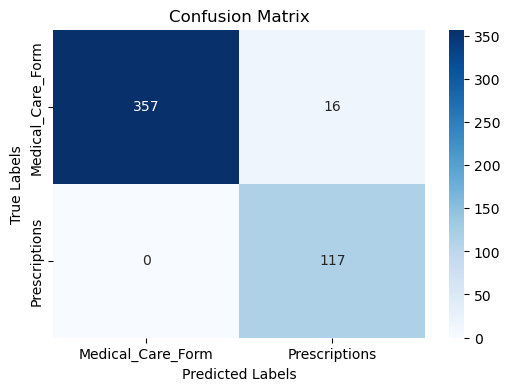

In [15]:
evaluate_model("pretrained_vgg_model.h5", validation_generator)

16/16 ━━━━━━━━━━━━━━━━━━━━ 42s 3s/step

Overall Model Performance:
Accuracy: 0.9673
Precision: 0.8797
Recall: 1.0000
F1-score: 0.9360
ROC-AUC: 0.9999
MSE: 0.0327


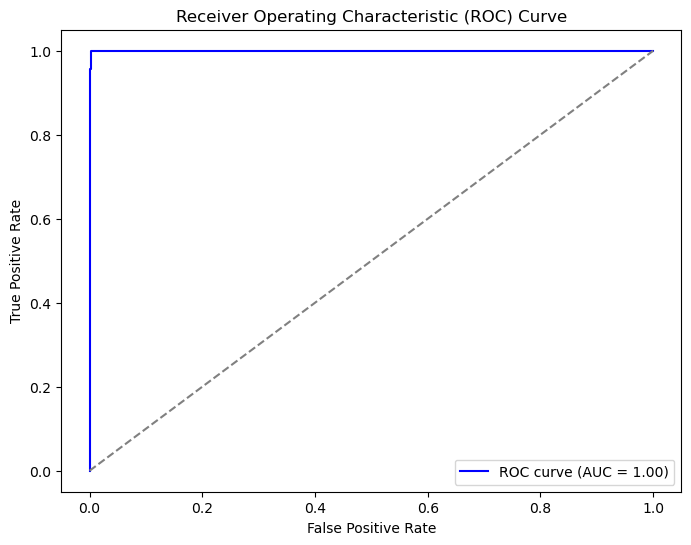

In [16]:
evaluate_model_performance(pretrained_model, validation_generator)

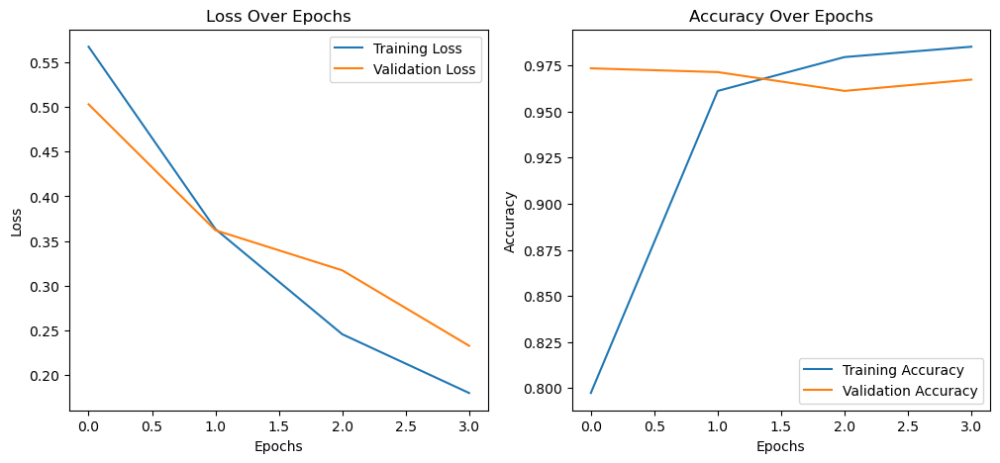

In [17]:
plot_training_history(history_pretrained_vgg)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


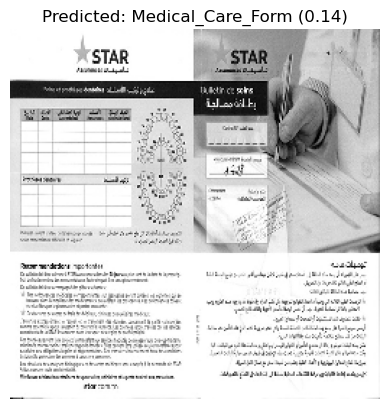

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


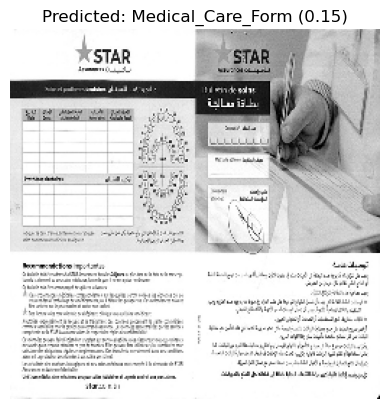

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


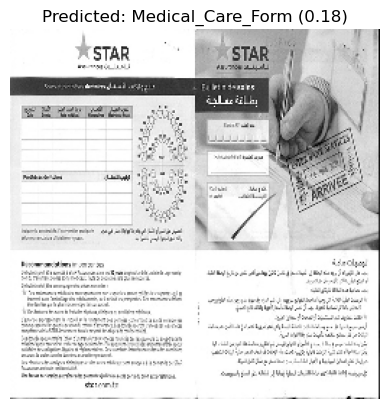

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


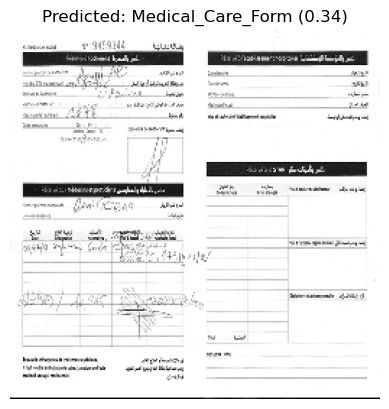

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


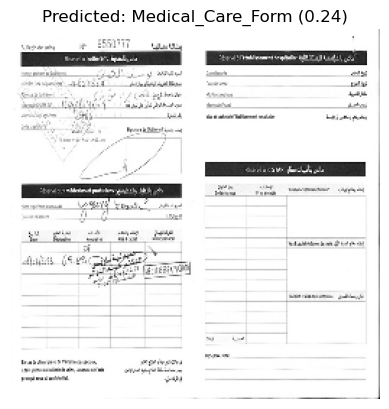

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


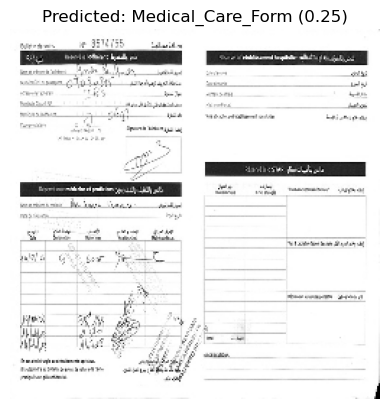

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


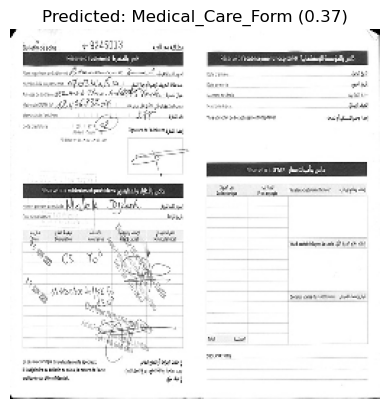

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


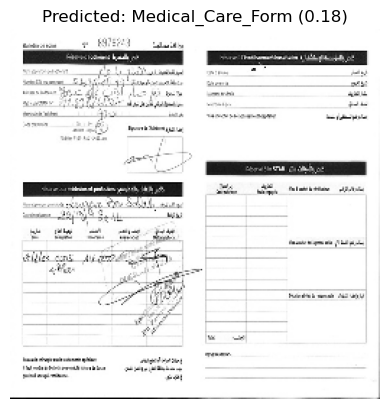

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


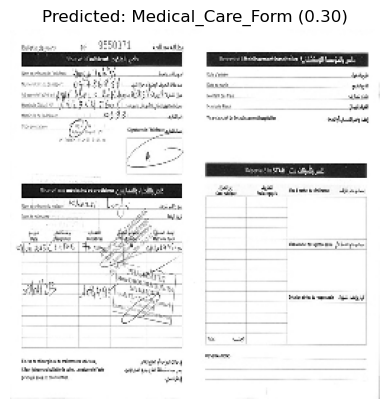

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


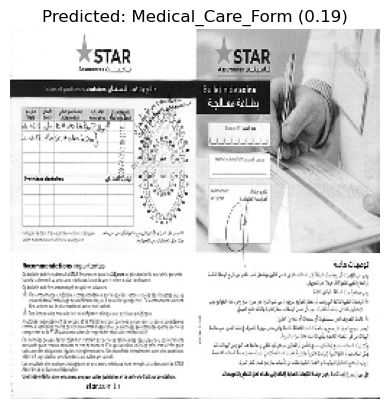

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


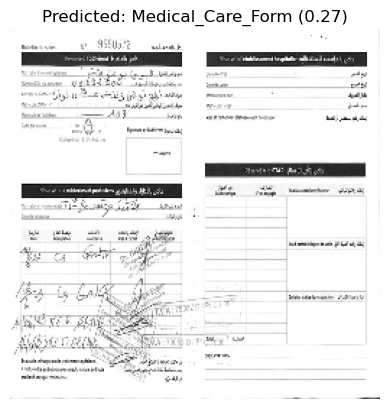

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


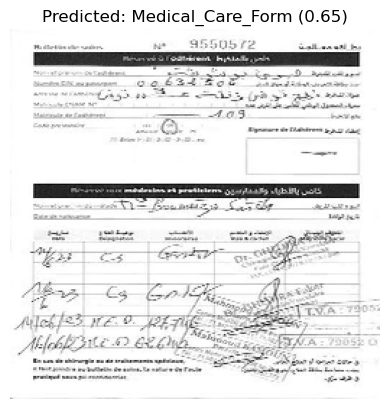

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


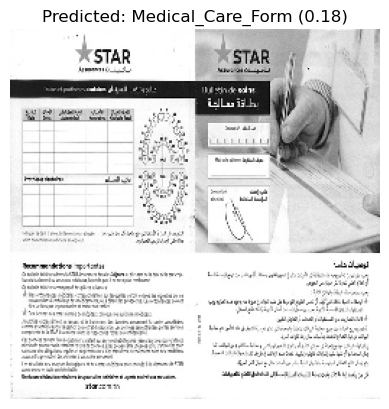

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


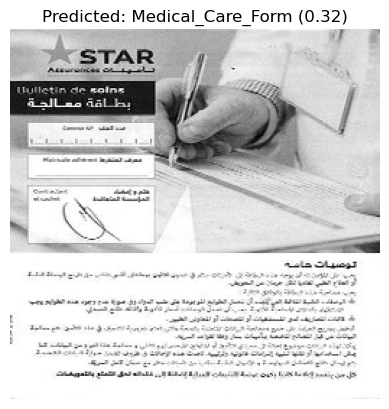

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


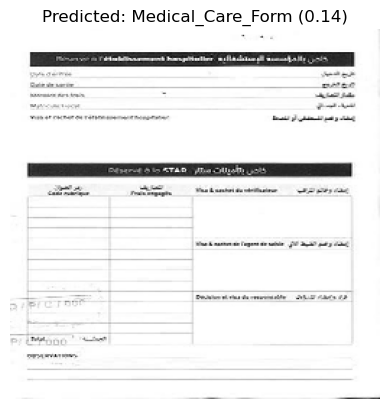

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


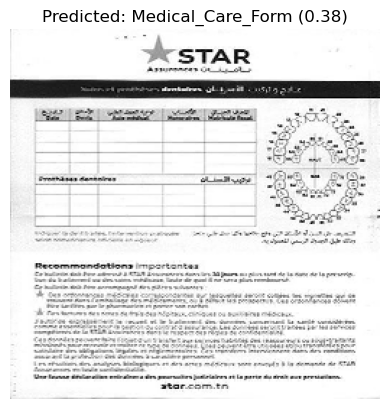

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


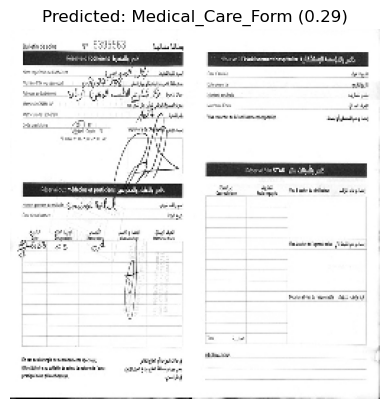

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


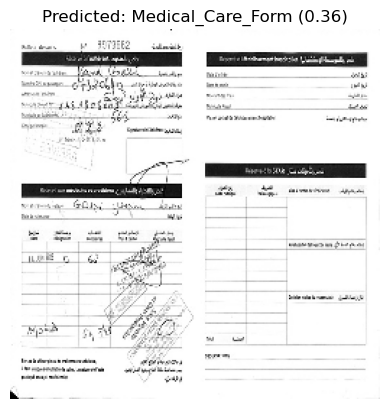

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


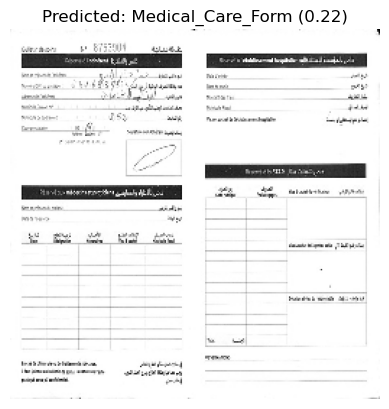

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


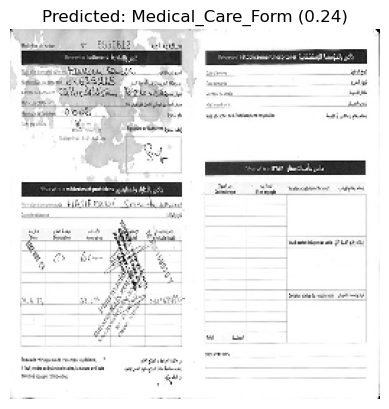

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


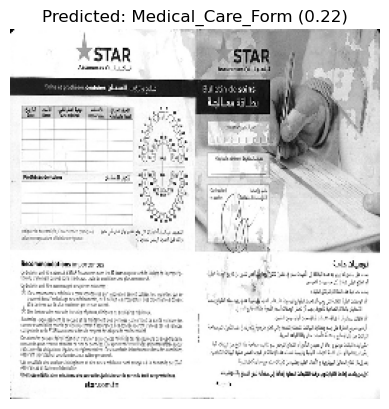

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


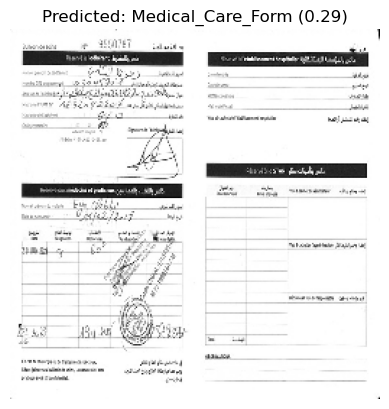

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


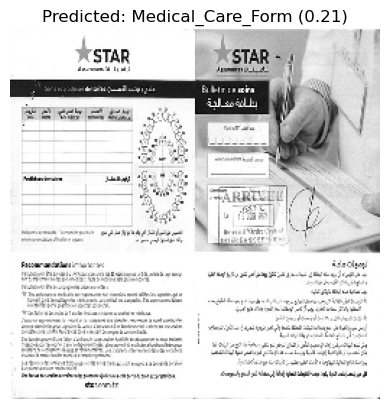

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


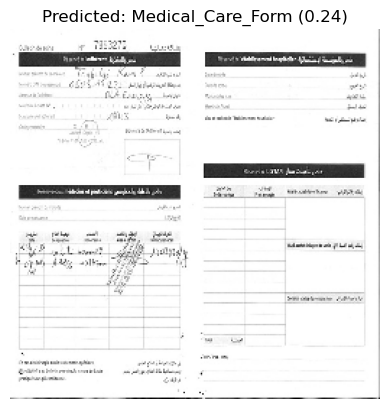

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


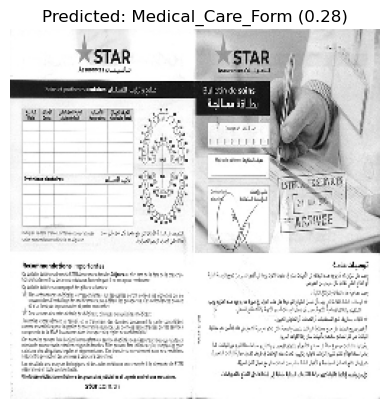

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


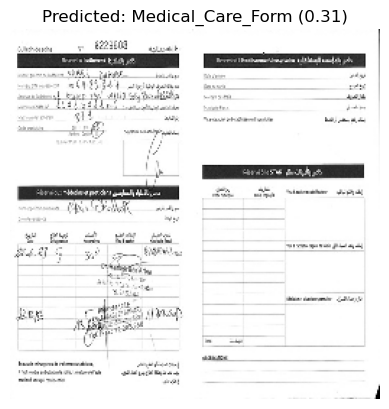

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


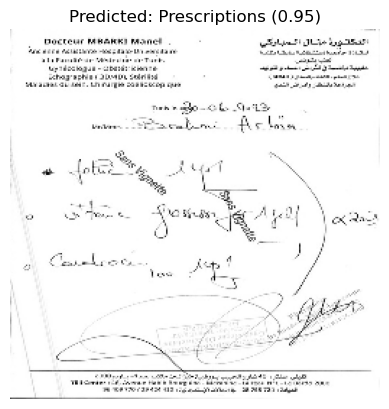

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


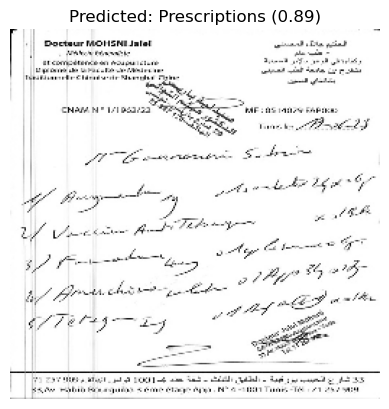

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


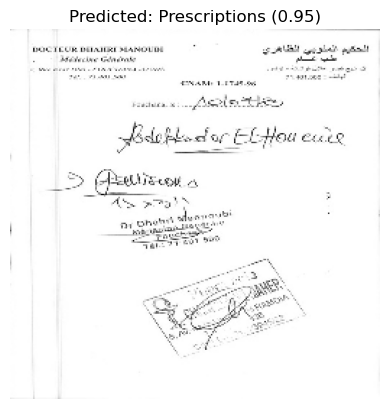

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


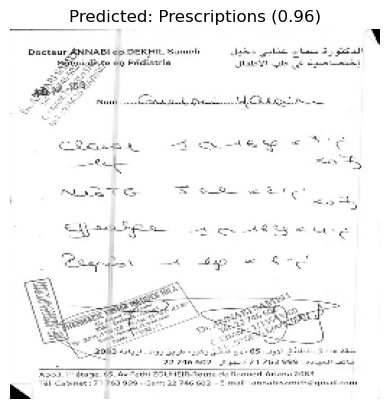

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


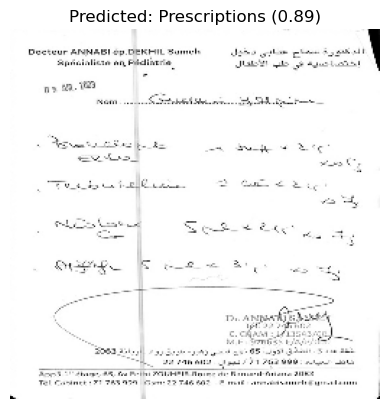

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


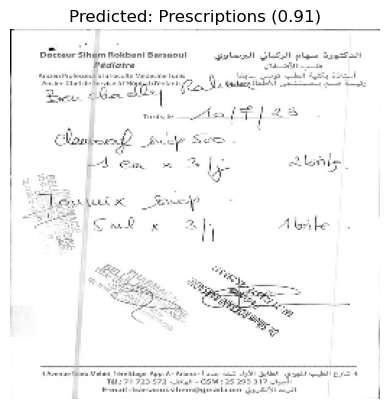

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


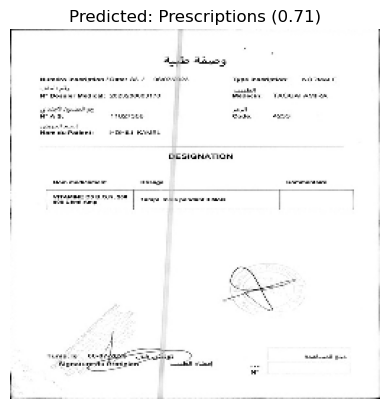

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


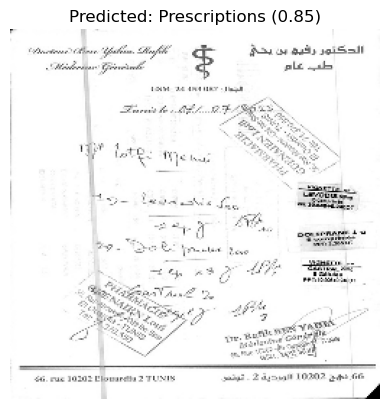

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


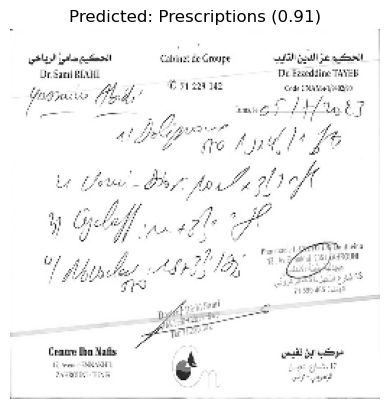

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


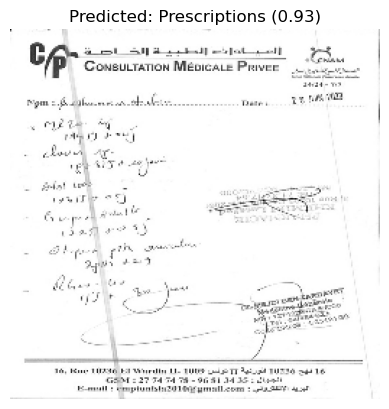

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


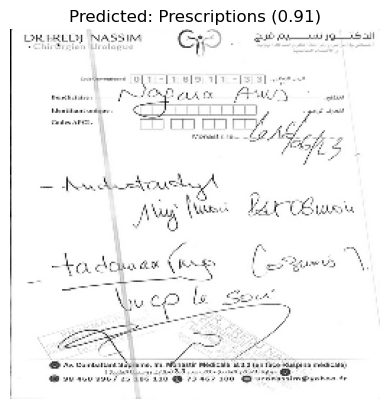

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


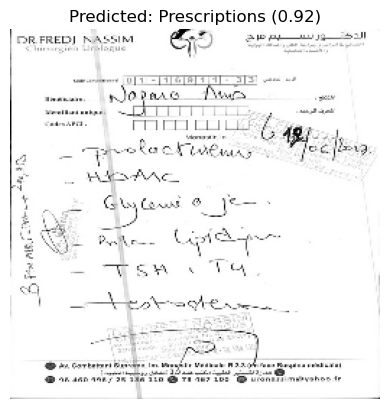

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


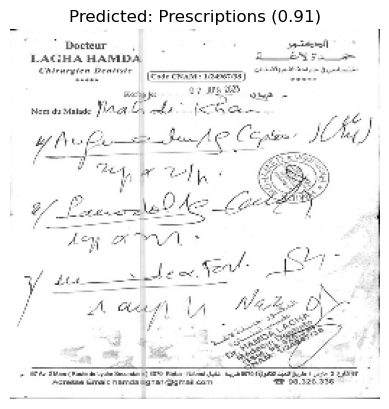

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


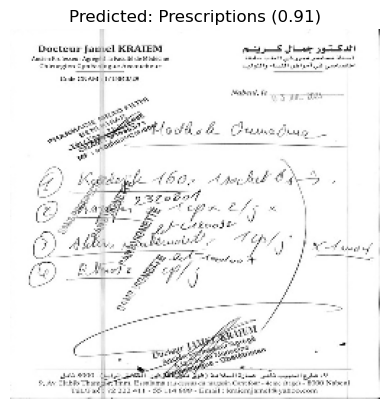

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


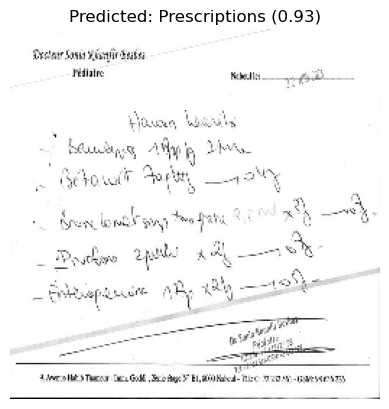

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


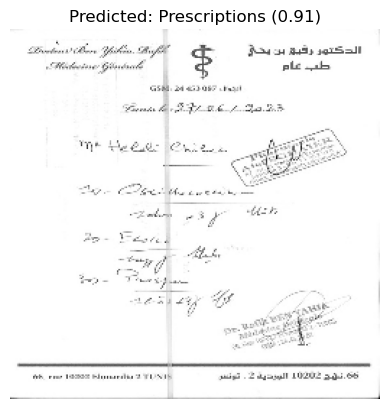

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


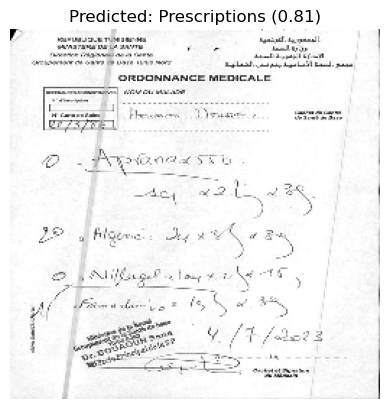

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


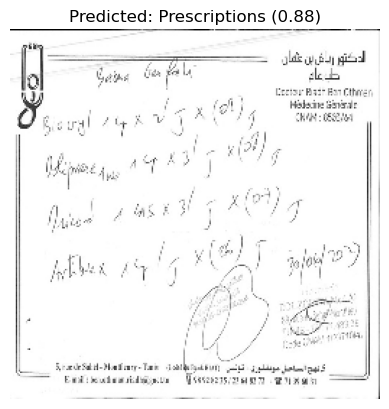

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


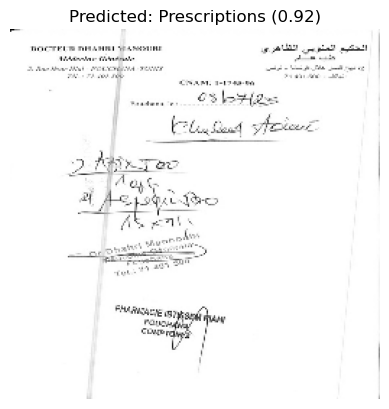

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


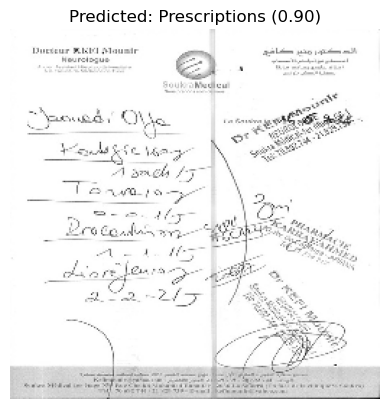

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


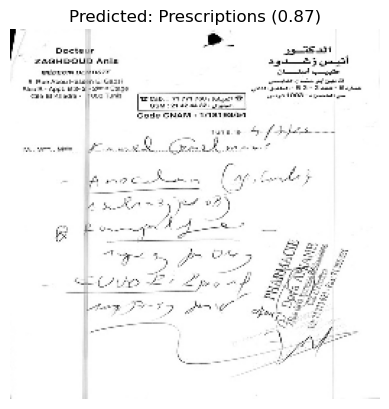

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


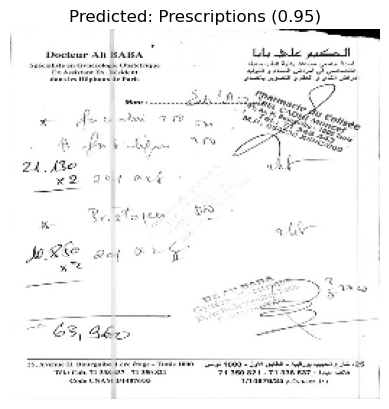

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


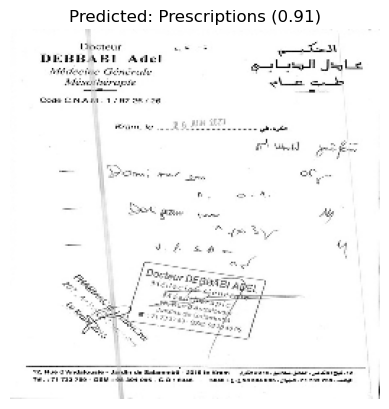

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


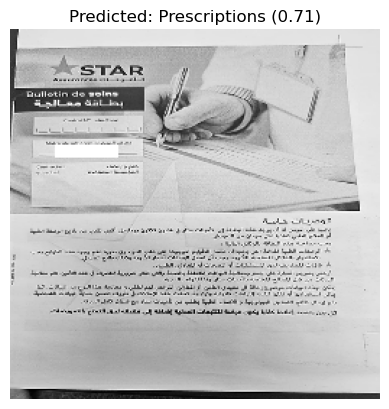

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


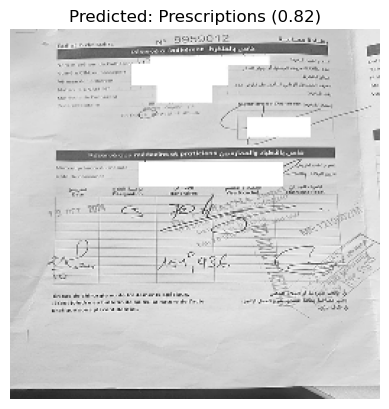

In [18]:
#test performance of pretrained model on the test set 
class_names = [name.replace("Processed_", "") for name in train_generator.class_indices.keys()]
test_folder_path = r"test_dataset"
display_images_and_predict(pretrained_model, test_folder_path, class_names)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
Image: 1668275707986.jpeg, Predicted Class: Prescriptions, Probability: 0.9530


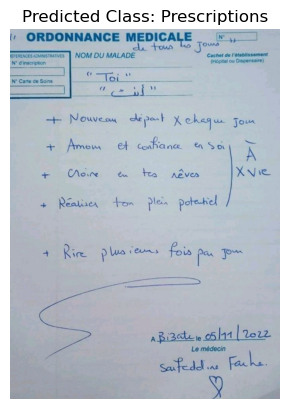

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
Image: 1a9a8acc-a134-4e18-8a7e-303efd6490c9.png, Predicted Class: Prescriptions, Probability: 0.5778


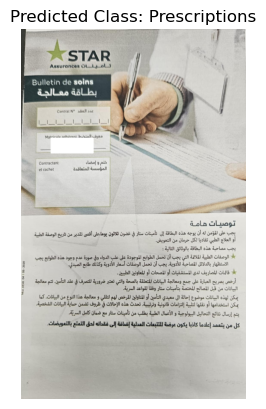

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
Image: 3c8e6c85-1191-4554-ba4c-013dfe24a1af (1).png, Predicted Class: Prescriptions, Probability: 0.7482


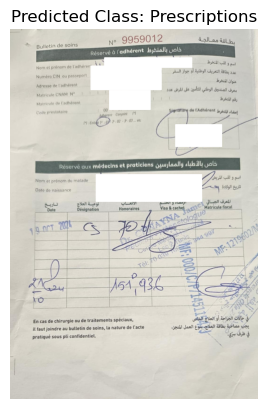

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
Image: 3d6ae565-23e7-4d42-b55a-a0970075063d.png, Predicted Class: Prescriptions, Probability: 0.7184


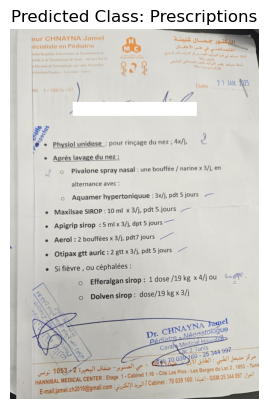

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
Image: 423568241_1085167485931888_2206447824091835237_n.png, Predicted Class: Medical_Care_Form, Probability: 0.3258


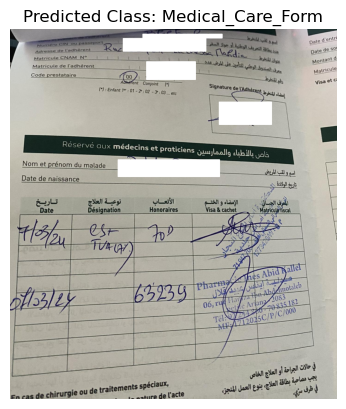

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
Image: 423619305_1461199547798124_5494216593614203976_n.png, Predicted Class: Prescriptions, Probability: 0.6778


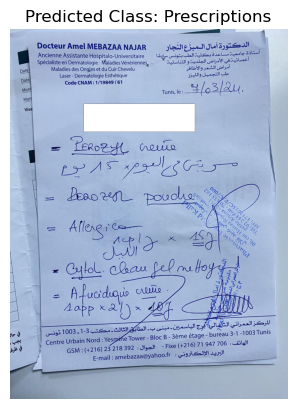

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
Image: 4275ce36-84df-4a3e-8b8e-c4a1872d3540.jpeg, Predicted Class: Prescriptions, Probability: 0.6273


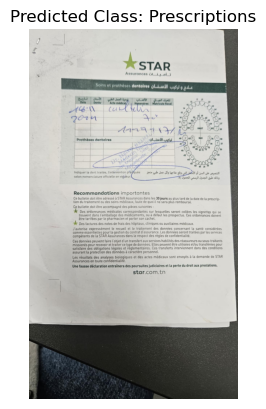

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
Image: 430890210_1360124484505691_7576348555829998378_n.png, Predicted Class: Medical_Care_Form, Probability: 0.2133


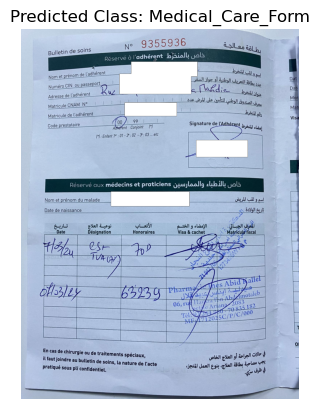

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
Image: 430911047_437977775243517_3123019589039676159_n.png, Predicted Class: Medical_Care_Form, Probability: 0.3114


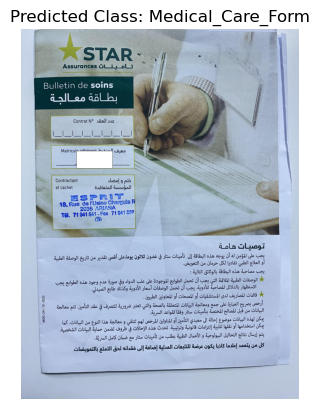

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
Image: 431053189_1458690305082326_5518977830508899765_n.png, Predicted Class: Prescriptions, Probability: 0.8641


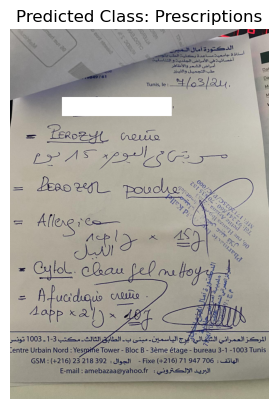

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
Image: 437284357_945985997021450_719262409630385928_n.jpg, Predicted Class: Medical_Care_Form, Probability: 0.2580


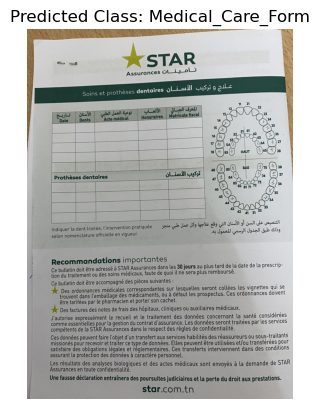

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
Image: 437309141_1578982486231687_1166633478136395242_n.png, Predicted Class: Prescriptions, Probability: 0.9071


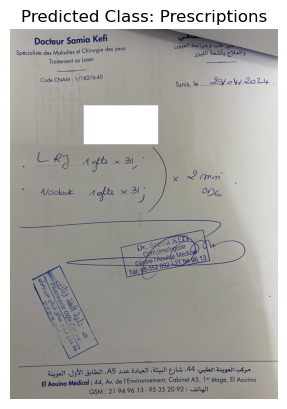

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
Image: 437527844_3759062270906998_7489606492394021737_n.png, Predicted Class: Prescriptions, Probability: 0.7373


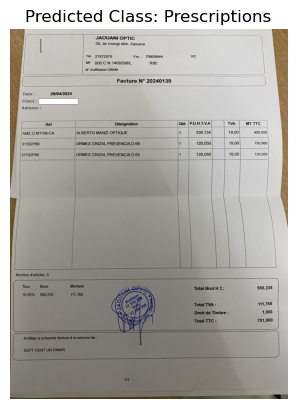

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
Image: 437570328_783826817027795_4517083124937635251_n.jpg, Predicted Class: Medical_Care_Form, Probability: 0.2490


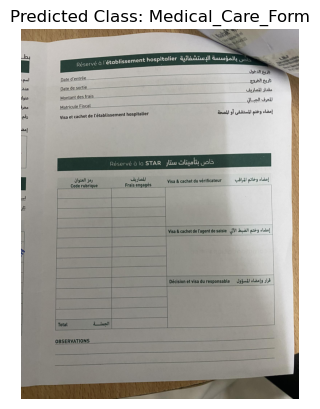

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
Image: 437684415_1444024722875900_5023633958174829810_n.png, Predicted Class: Prescriptions, Probability: 0.8889


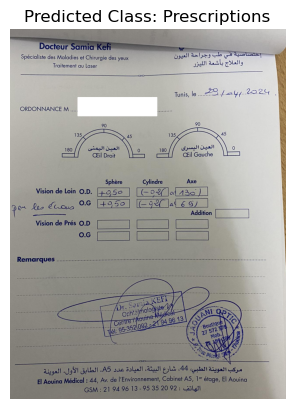

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
Image: 437695409_2283037495223502_2215975148015573899_n.jpg, Predicted Class: Prescriptions, Probability: 0.7122


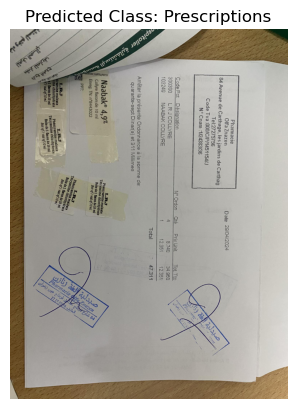

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
Image: 440828430_1484489785470850_257671477554688986_n.png, Predicted Class: Medical_Care_Form, Probability: 0.4503


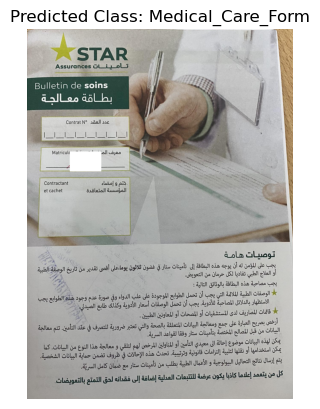

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
Image: 67eb8db5-bcea-48b0-809f-e9bc321c98b8.png, Predicted Class: Prescriptions, Probability: 0.9423


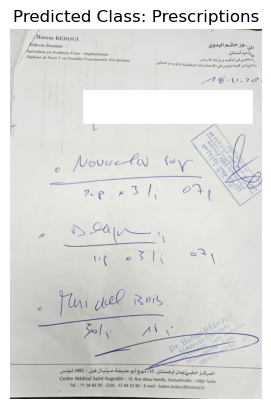

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
Image: 6fb4b493-ed73-41b5-be0c-3bbca201cb9b (1).png, Predicted Class: Prescriptions, Probability: 0.9484


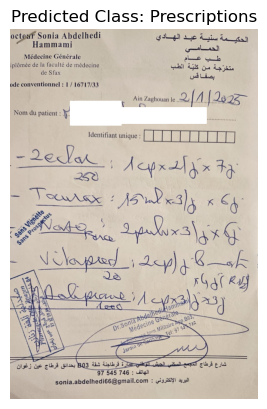

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
Image: 7249eb64-0674-4004-afe5-5bbbb9611404.png, Predicted Class: Prescriptions, Probability: 0.5509


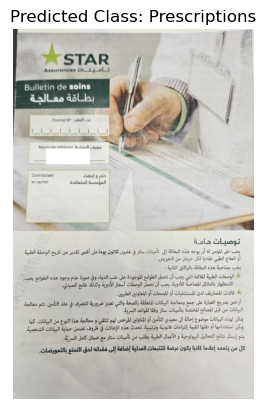

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
Image: 7ba84d7c-d722-4350-a66b-98611fa8c03f.png, Predicted Class: Prescriptions, Probability: 0.6407


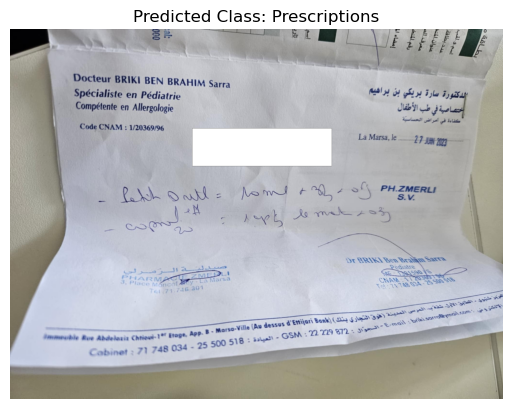

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
Image: 8418f58b-43d9-4d05-961d-f1968c23ef42 (1).png, Predicted Class: Medical_Care_Form, Probability: 0.4164


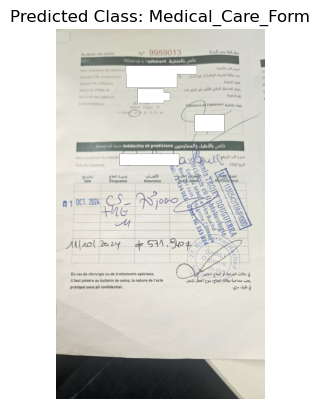

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
Image: 84d9e4d1-8a37-49c8-853e-e93f9538deb5.png, Predicted Class: Prescriptions, Probability: 0.9419


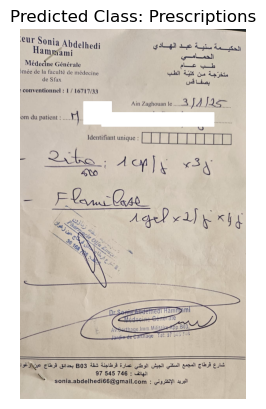

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
Image: 936018f5-2453-4256-9575-7f0278615ed4 (1).png, Predicted Class: Prescriptions, Probability: 0.8645


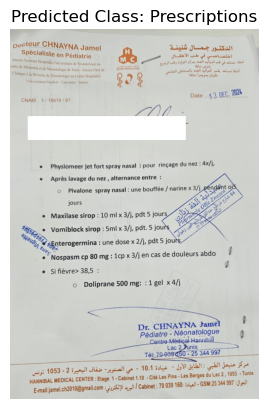

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
Image: ad1973fb-be32-4061-bc65-6ce0b1fea7ee (1).jpeg, Predicted Class: Prescriptions, Probability: 0.7835


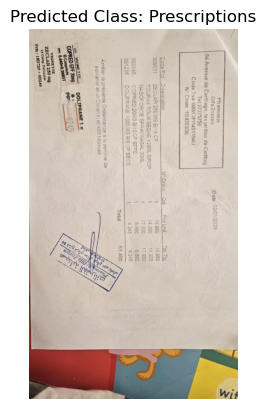

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
Image: ayoub.jpeg, Predicted Class: Prescriptions, Probability: 0.9084


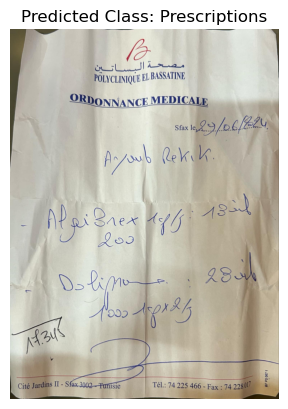

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
Image: BN22257ordonnance-medicale-winou-el-petrole.jpg, Predicted Class: Prescriptions, Probability: 0.9337


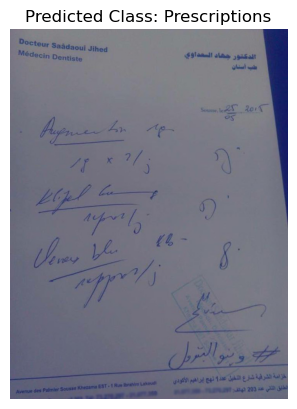

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
Image: c9f13968-1910-4b96-9e63-618c3aa37d95.png, Predicted Class: Prescriptions, Probability: 0.8088


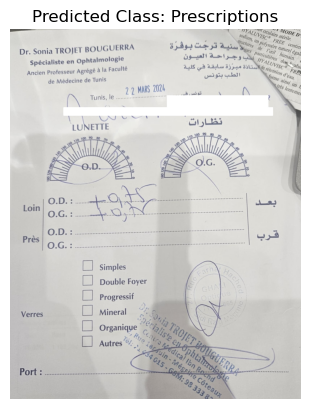

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
Image: dbfb91a1-9975-48c3-8f86-bfa4e7fffb0b.png, Predicted Class: Medical_Care_Form, Probability: 0.2308


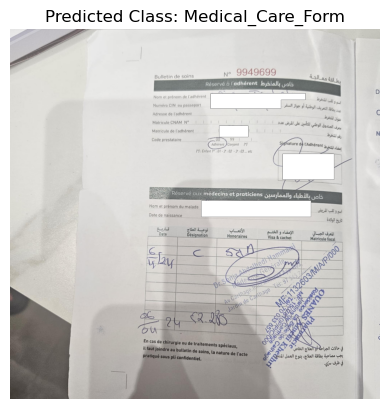

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
Image: dc5c1f04-c233-4e68-b42b-2c3216fe7308.png, Predicted Class: Medical_Care_Form, Probability: 0.3311


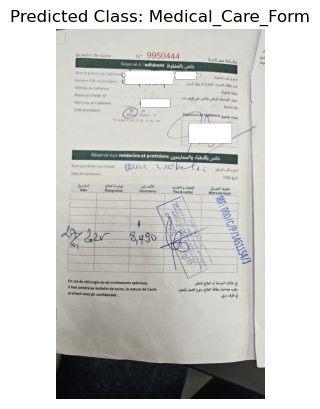

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
Image: dfd6ef0f-f8d3-4b07-9775-ed8b9b76f2c3 (1).png, Predicted Class: Medical_Care_Form, Probability: 0.4952


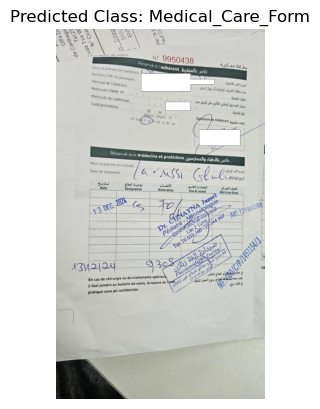

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
Image: e02afbab-3150-42e4-92a6-43b5a960cdb5 (1).png, Predicted Class: Prescriptions, Probability: 0.8625


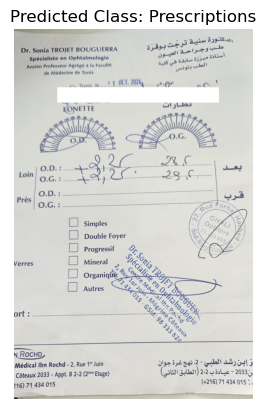

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
Image: e3034721-4b07-44e4-a167-2802acb2c93d.png, Predicted Class: Prescriptions, Probability: 0.7110


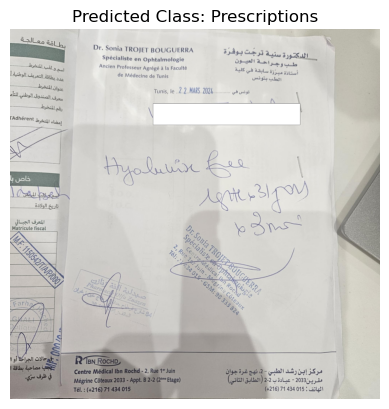

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
Image: e6a0230e-1eed-4ca2-8b23-3cd03f48b5c9.png, Predicted Class: Prescriptions, Probability: 0.8069


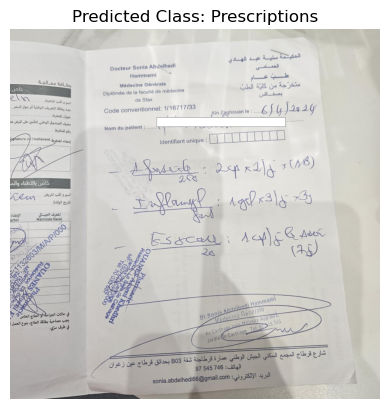

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
Image: ee6e0ce4-c52e-46b8-b381-ad479ecd681b.jpeg, Predicted Class: Prescriptions, Probability: 0.8461


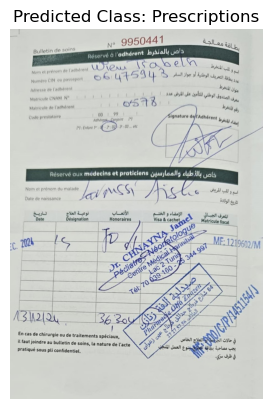

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
Image: images (1).jpeg, Predicted Class: Medical_Care_Form, Probability: 0.1450


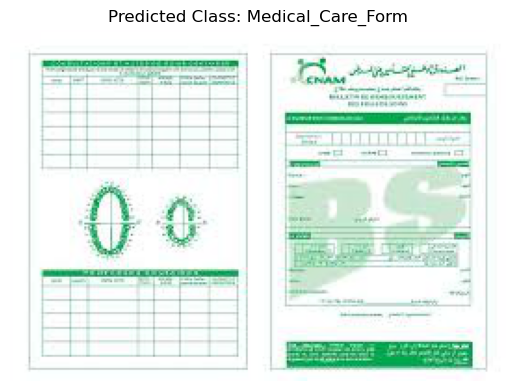

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
Image: images.jpeg, Predicted Class: Prescriptions, Probability: 0.8832


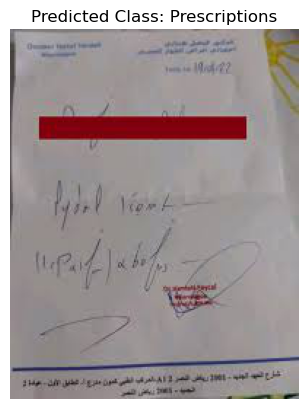

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
Image: IMG-20250201-WA0002.jpg, Predicted Class: Medical_Care_Form, Probability: 0.4320


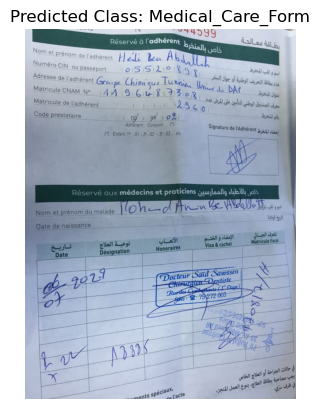

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
Image: IMG-20250201-WA0004.jpg, Predicted Class: Prescriptions, Probability: 0.8195


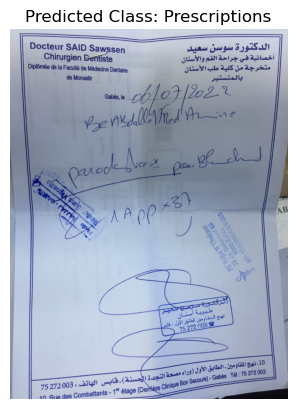

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
Image: IMG-20250201-WA0005.jpg, Predicted Class: Medical_Care_Form, Probability: 0.3891


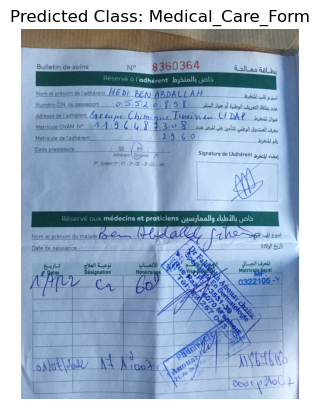

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
Image: IMG-20250201-WA0006.jpg, Predicted Class: Prescriptions, Probability: 0.8996


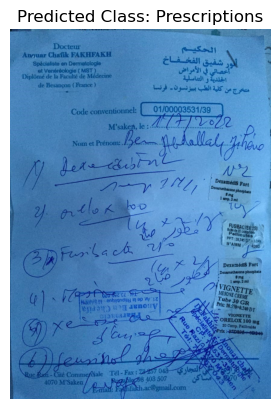

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
Image: IMG-20250201-WA0007.jpg, Predicted Class: Prescriptions, Probability: 0.7840


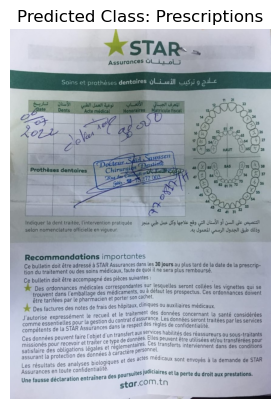

In [19]:
folder_path = "test_images"
predict_images_in_folder(pretrained_model, folder_path, class_names)

### Fine-Tuning the pre-trained VGG16 Model

After evaluating the performance of the pre-trained VGG16 model, we determined that fine-tuning is not necessary as the model already provides strong performance without it.

## Step 2: Training Our Own CNN Model

In this step, we create and train our own Convolutional Neural Network (CNN) model for the dataset.

1. **Model Architecture**:  
   The model consists of:
   - 3 convolutional layers with increasing filter sizes (32, 64, 128).
   - Max-pooling layers after each convolutional layer to reduce spatial dimensions.
   - Dropout layers to prevent overfitting by randomly setting a fraction of input units to 0 during training.
   - A dense layer with 512 units and ReLU activation for learning non-linear combinations of features.
   - The output layer uses a sigmoid activation function for binary classification.

2. **Model Compilation**:  
   We compile the model with the Adam optimizer (learning rate 0.0005) and binary cross-entropy loss.

3. **Callbacks**:  
   - **EarlyStopping**: This monitors the validation loss and stops training early if the loss does not improve, helping to avoid overfitting.
   - **ReduceLROnPlateau**: This reduces the learning rate by a factor of 0.5 if the validation loss plateaus, enabling finer adjustments to the model's parameters.

4. **Training the Model**:  
   The model is trained for 10 epochs with class weights to address class imbalance, using both the training and validation data generators.

In [20]:
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)), 
    MaxPooling2D(pool_size=(2, 2)),
    
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Dropout(0.4),
    
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Dropout(0.4),
    
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(0.5),
    
    Dense(1, activation='sigmoid')
])

model.compile(optimizer=Adam(learning_rate=0.0005), loss='binary_crossentropy', metrics=['accuracy'])

early_stopping = EarlyStopping(
    monitor='val_loss',  
    patience=3,          
    restore_best_weights=True  
)

lr_scheduler = ReduceLROnPlateau(
    monitor='val_loss',  
    factor=0.5,          
    patience=2,          
    min_lr=1e-6          
)

history = model.fit(
    train_generator,
    epochs=10,
    validation_data=validation_generator,  
    class_weight=class_weights, 
    callbacks=[early_stopping, lr_scheduler]
)


C:\Users\ASUS\AppData\Roaming\Python\Python311\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 80s 1s/step - accuracy: 0.6745 - loss: 1.0607 - val_accuracy: 0.9490 - val_loss: 0.1848 - learning_rate: 5.0000e-04
Epoch 2/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 73s 1s/step - accuracy: 0.9653 - loss: 0.1231 - val_accuracy: 0.9694 - val_loss: 0.0916 - learning_rate: 5.0000e-04
Epoch 3/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 74s 1s/step - accuracy: 0.9610 - loss: 0.1619 - val_accuracy: 0.9816 - val_loss: 0.0781 - learning_rate: 5.0000e-04
Epoch 4/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 72s 1s/step - accuracy: 0.9757 - loss: 0.0828 - val_accuracy: 0.9776 - val_loss: 0.0896 - learning_rate: 5.0000e-04
Epoch 5/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 72s 1s/step - accuracy: 0.9863 - loss: 0.0467 - val_accuracy: 0.9776 - val_loss: 0.1185 - learning_rate: 5.0000e-04
Epoch 6/10
62/62 ━━━━━━━━━━━━━━━━━━━━ 72s 1s/step - accuracy: 0.9841 - loss: 0.0538 - val_accuracy: 0.9776 - val_loss: 0.0973 - learning_rate: 2.5000e-04


In [21]:
model.save('CNN_model.h5')

In [22]:
#evaluate the model: accuracy, confusion matrix, f1, precision..
val_loss, val_acc = model.evaluate(validation_generator)
print(f'Validation Loss: {val_loss}')
print(f'Validation Accuracy: {val_acc}')

16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 167ms/step - accuracy: 0.9852 - loss: 0.0592
Validation Loss: 0.07805696129798889
Validation Accuracy: 0.981632649898529


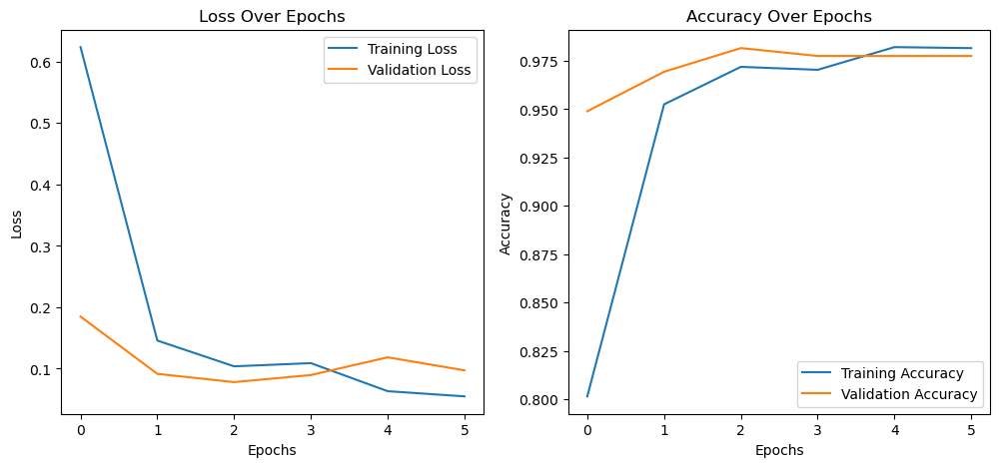

In [23]:
plot_training_history(history)

16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 172ms/step
Confusion Matrix:
[[365   8]
 [  1 116]]
Classification Report:
                   precision    recall  f1-score   support

Medical_Care_Form       1.00      0.98      0.99       373
    Prescriptions       0.94      0.99      0.96       117

         accuracy                           0.98       490
        macro avg       0.97      0.99      0.98       490
     weighted avg       0.98      0.98      0.98       490



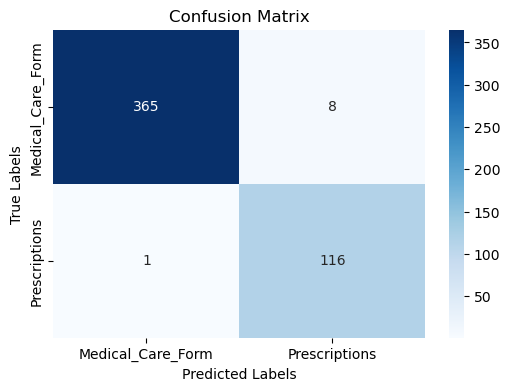

In [24]:
evaluate_model("CNN_model.h5", validation_generator)

In [25]:
model = load_model("CNN_model.h5") 

16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 178ms/step

Overall Model Performance:
Accuracy: 0.9816
Precision: 0.9355
Recall: 0.9915
F1-score: 0.9627
ROC-AUC: 0.9937
MSE: 0.0184


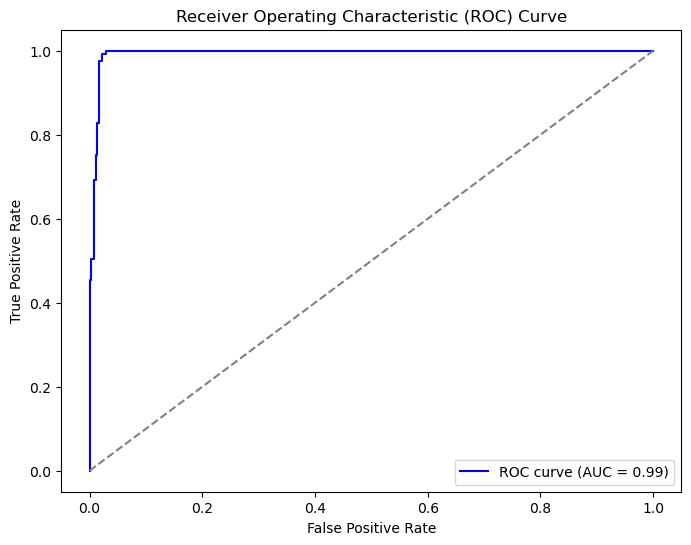

In [26]:
evaluate_model_performance(model, validation_generator)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


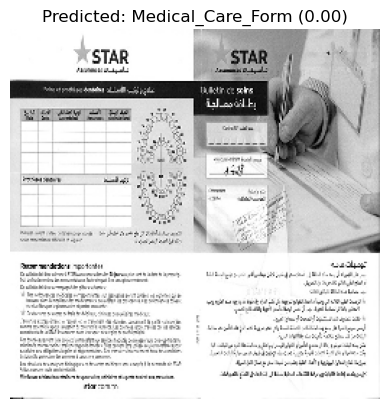

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


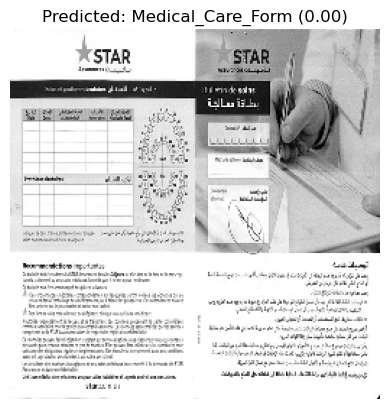

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


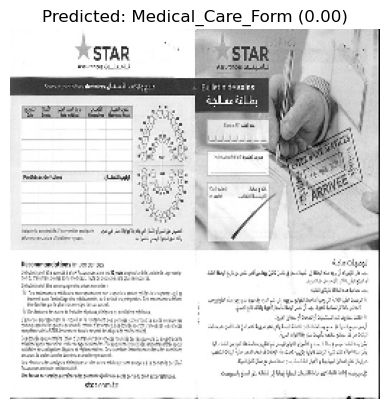

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


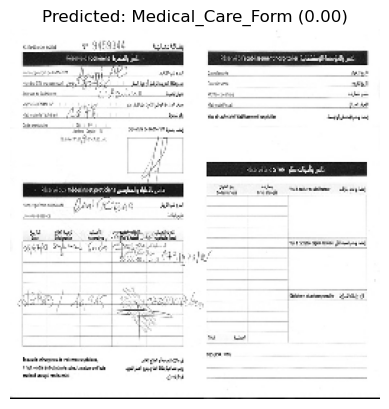

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


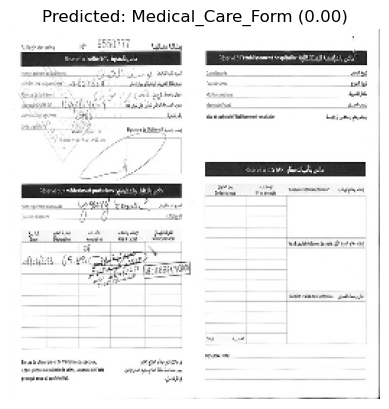

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


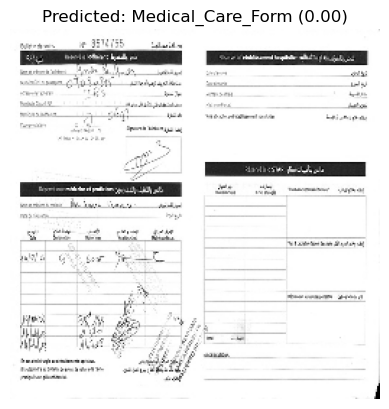

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


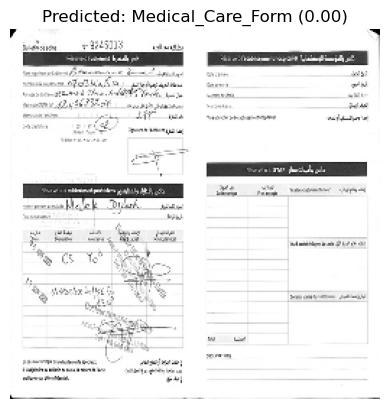

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


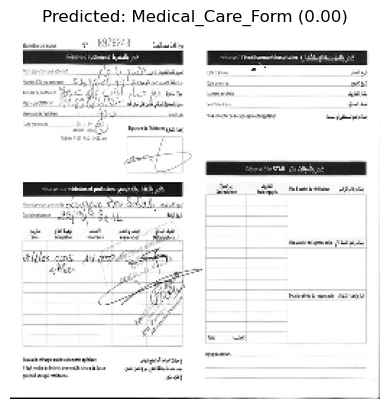

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


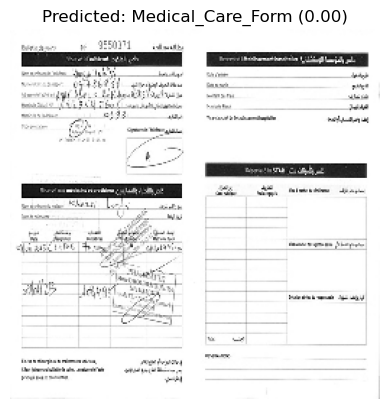

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


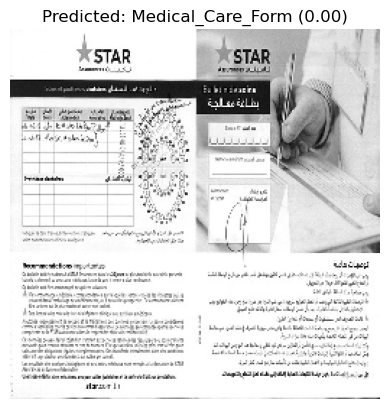

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


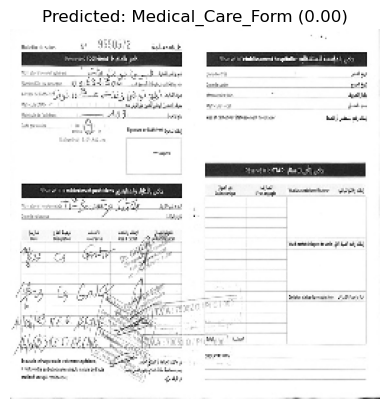

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


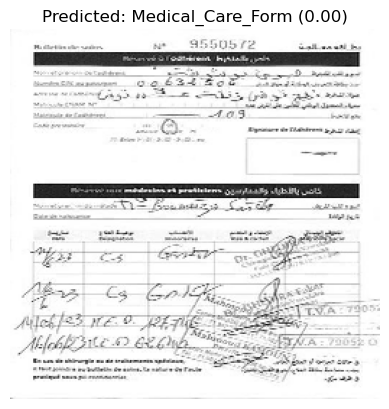

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


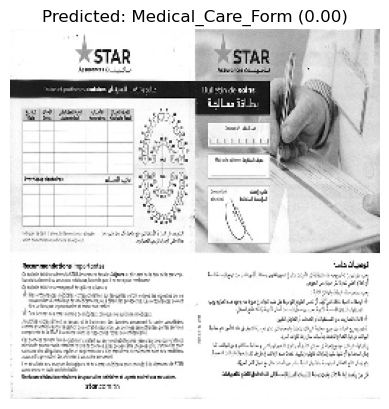

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


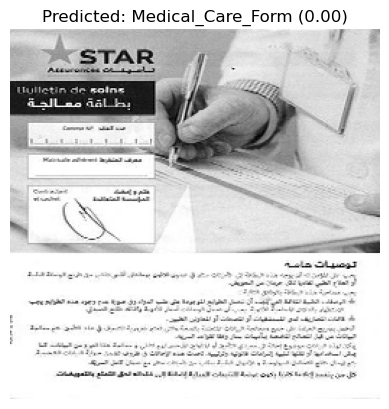

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


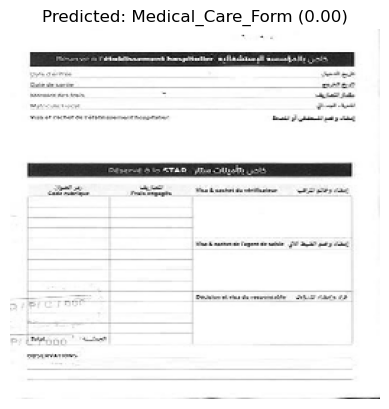

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


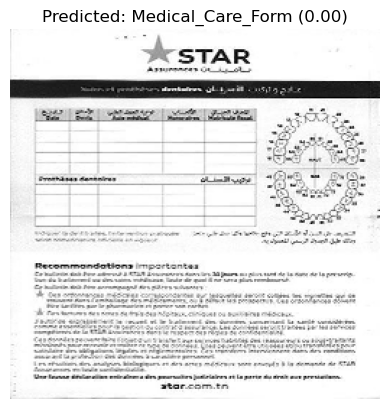

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


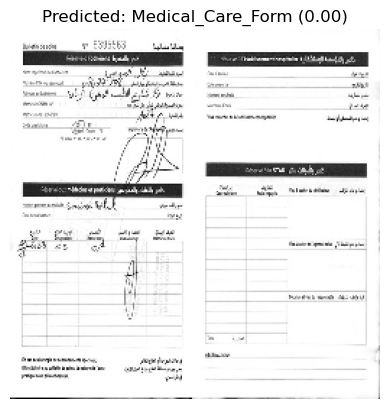

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


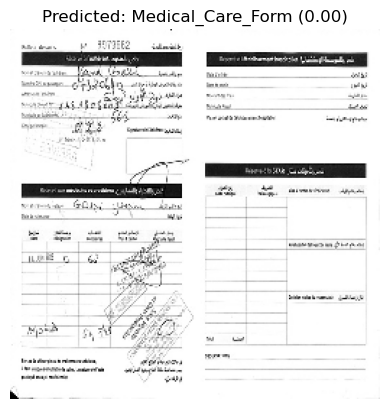

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


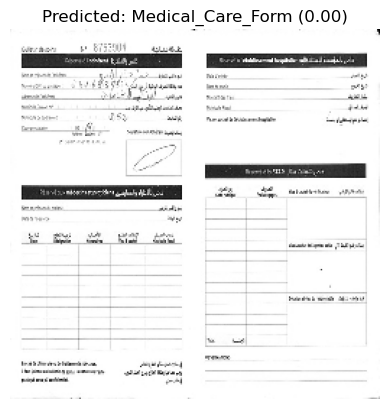

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


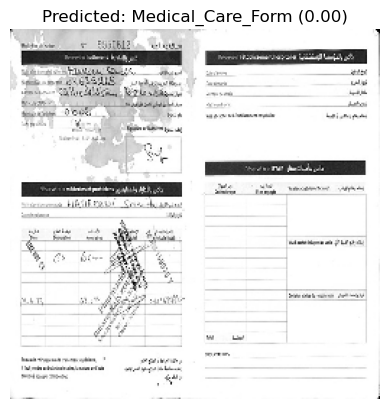

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


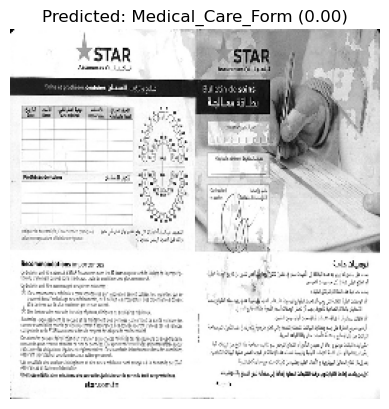

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


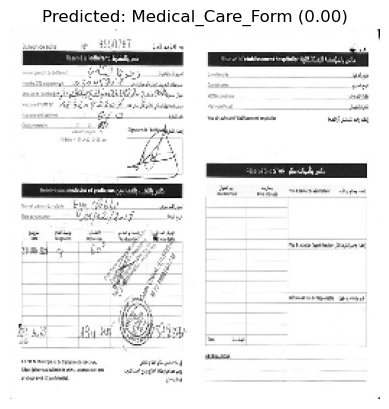

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


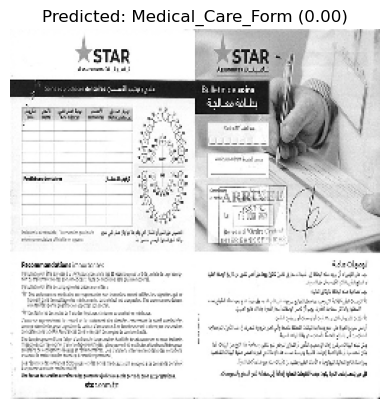

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


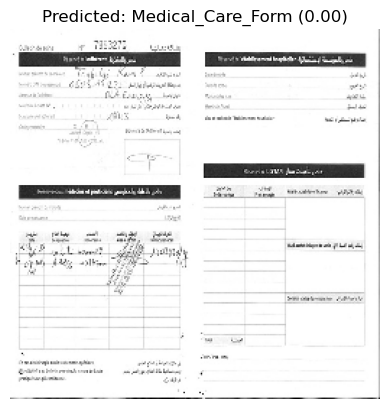

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


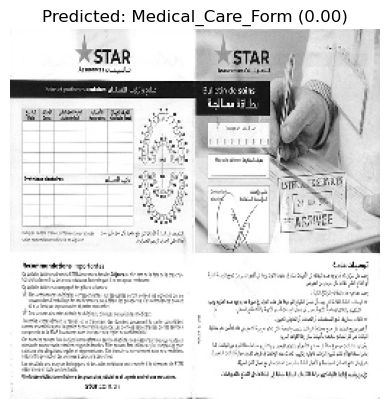

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


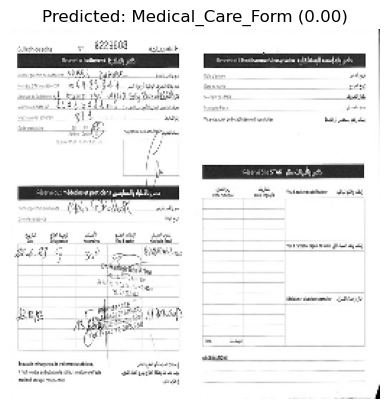

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


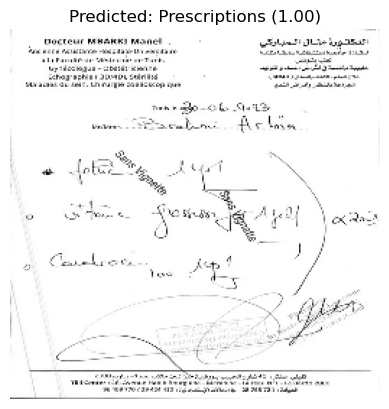

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


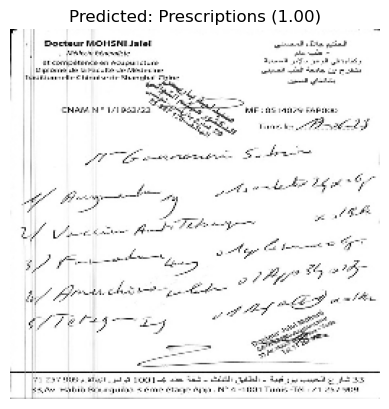

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


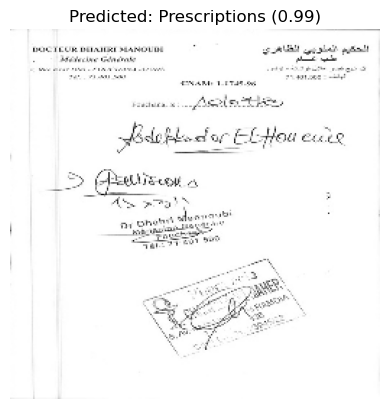

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


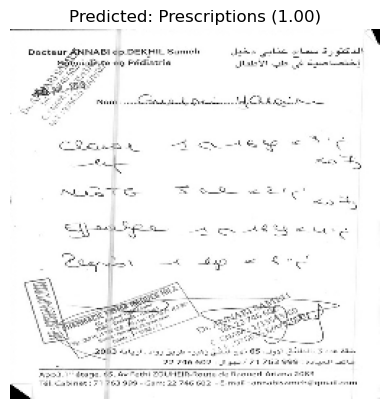

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


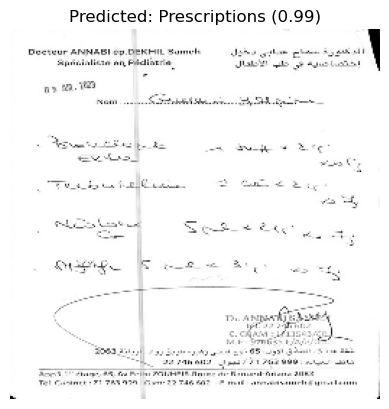

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


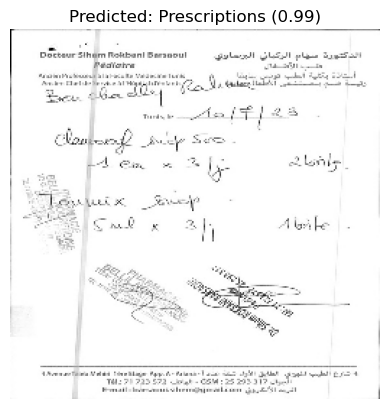

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


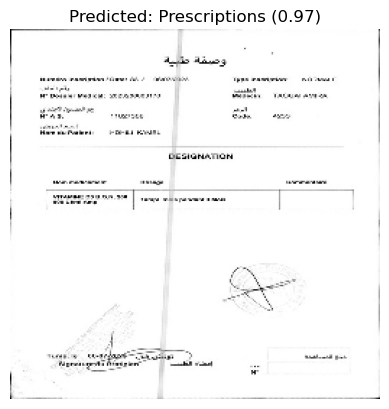

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


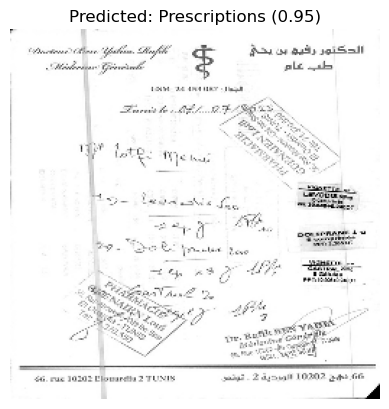

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


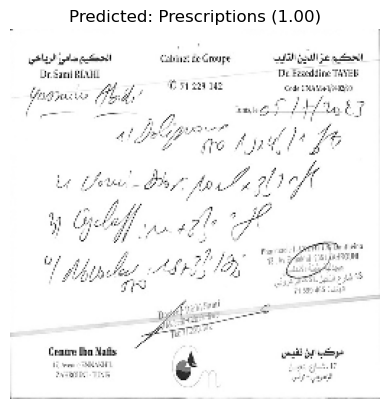

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


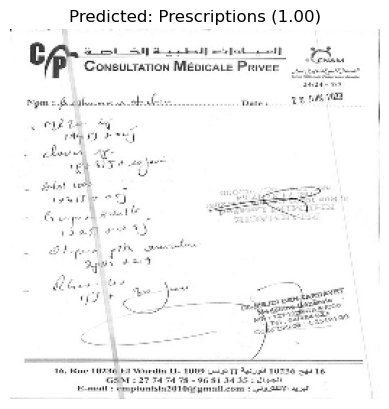

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


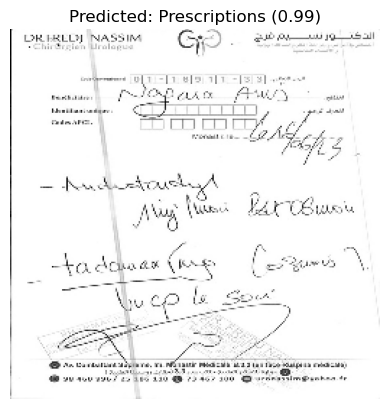

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


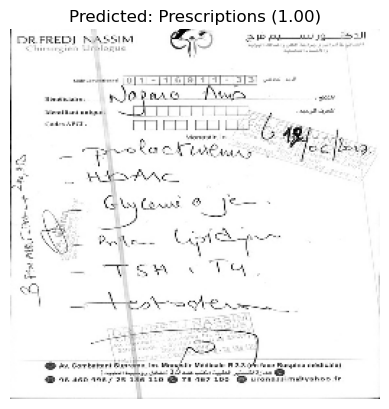

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


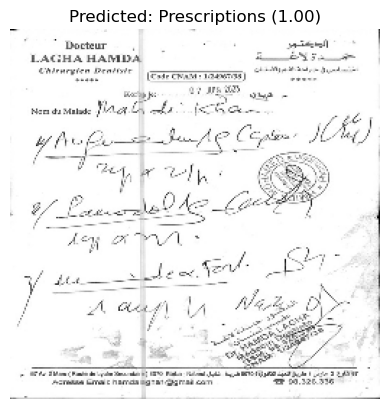

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


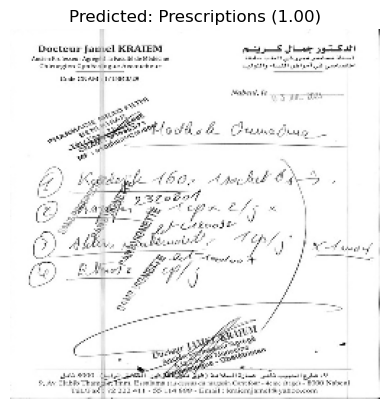

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


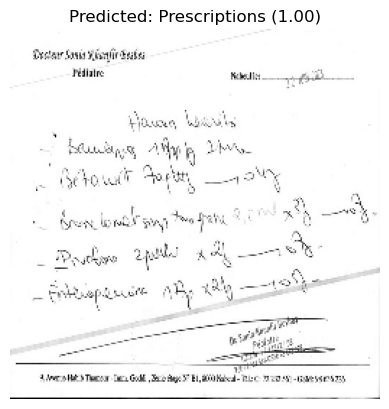

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


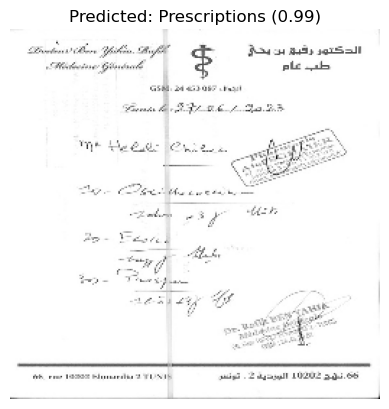

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


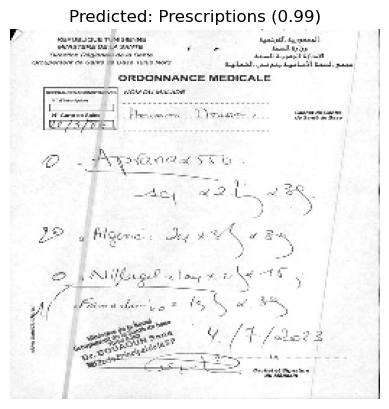

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


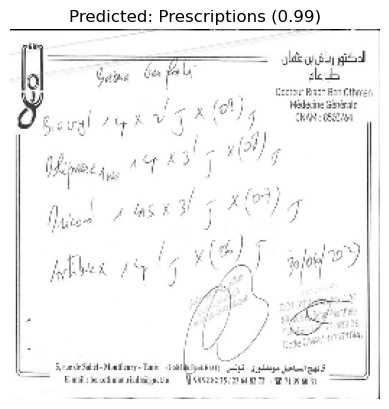

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


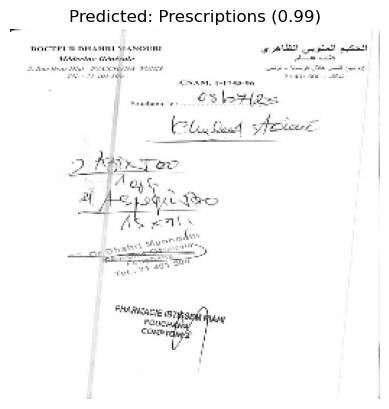

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


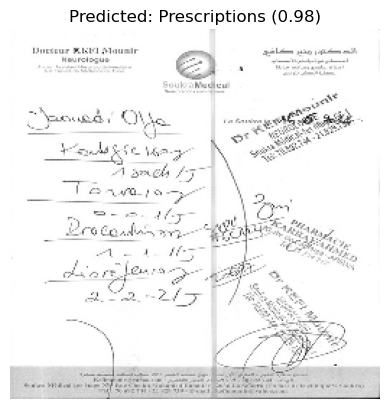

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


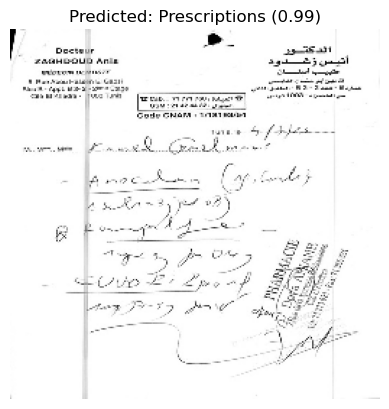

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


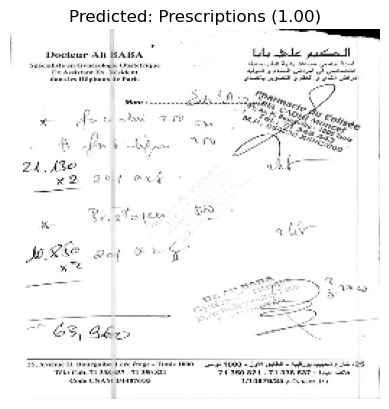

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


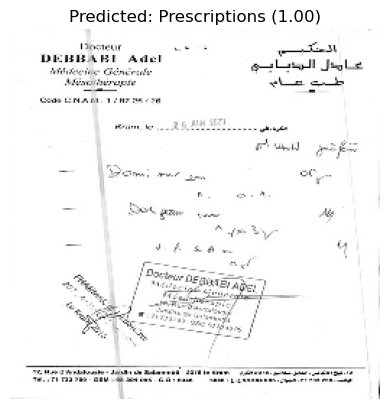

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


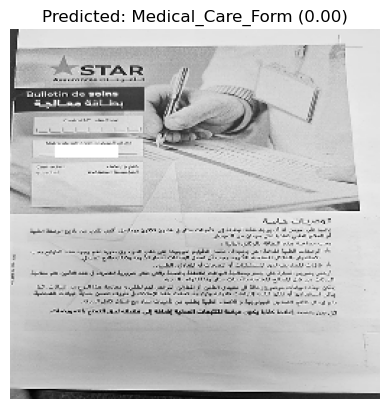

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


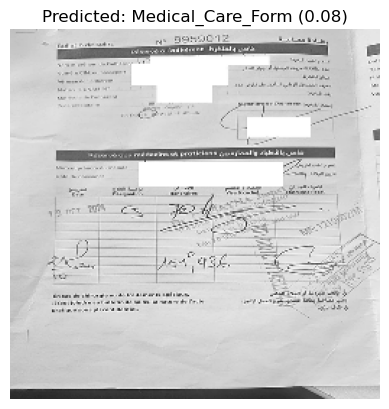

In [27]:
class_names = [name.replace("Processed_", "") for name in train_generator.class_indices.keys()]
test_folder_path = r"test_dataset"
display_images_and_predict(model, test_folder_path, class_names)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Image: 1668275707986.jpeg, Predicted Class: Prescriptions, Probability: 0.9618


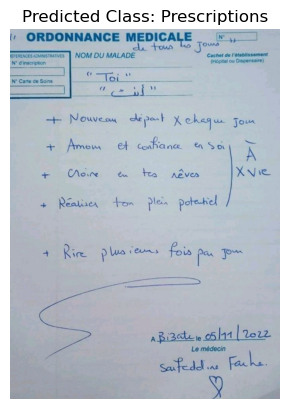

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Image: 1a9a8acc-a134-4e18-8a7e-303efd6490c9.png, Predicted Class: Medical_Care_Form, Probability: 0.0003


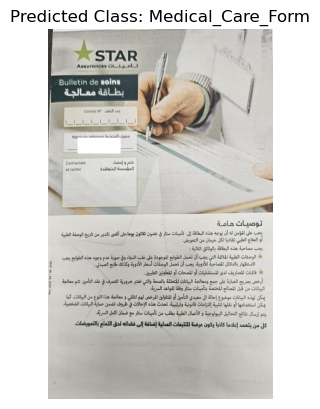

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Image: 3c8e6c85-1191-4554-ba4c-013dfe24a1af (1).png, Predicted Class: Medical_Care_Form, Probability: 0.0001


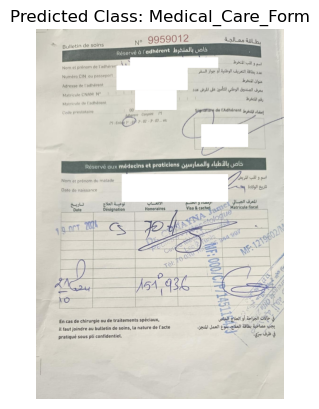

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Image: 3d6ae565-23e7-4d42-b55a-a0970075063d.png, Predicted Class: Prescriptions, Probability: 0.9748


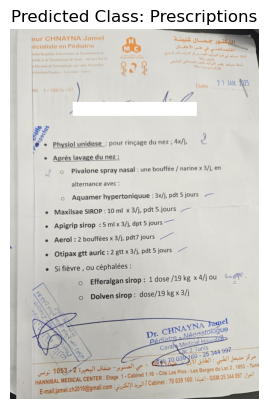

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Image: 423568241_1085167485931888_2206447824091835237_n.png, Predicted Class: Medical_Care_Form, Probability: 0.0000


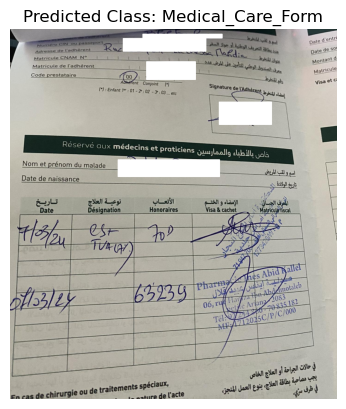

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Image: 423619305_1461199547798124_5494216593614203976_n.png, Predicted Class: Prescriptions, Probability: 0.9952


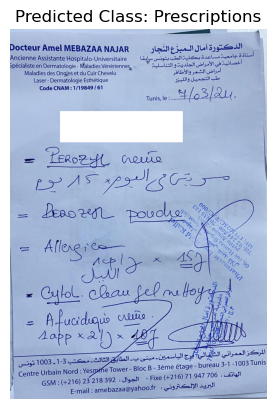

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Image: 4275ce36-84df-4a3e-8b8e-c4a1872d3540.jpeg, Predicted Class: Medical_Care_Form, Probability: 0.3521


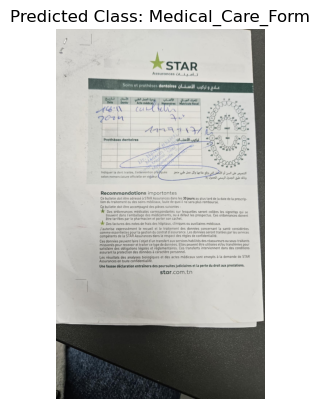

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
Image: 430890210_1360124484505691_7576348555829998378_n.png, Predicted Class: Medical_Care_Form, Probability: 0.0000


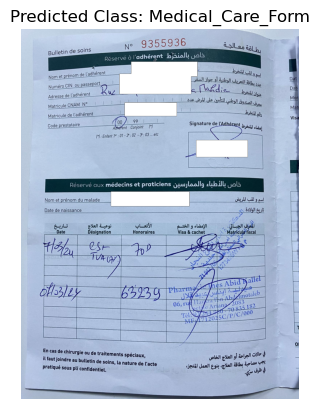

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Image: 430911047_437977775243517_3123019589039676159_n.png, Predicted Class: Medical_Care_Form, Probability: 0.0000


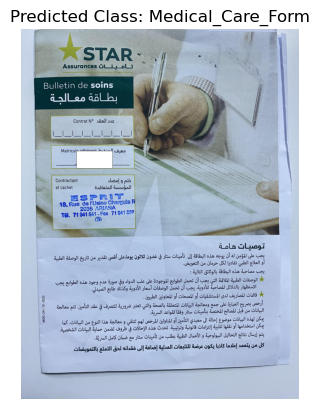

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Image: 431053189_1458690305082326_5518977830508899765_n.png, Predicted Class: Prescriptions, Probability: 0.9853


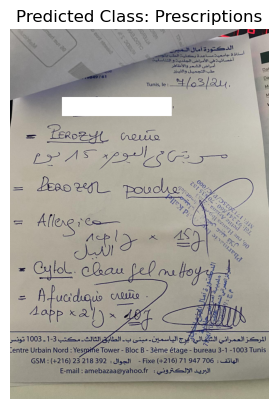

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Image: 437284357_945985997021450_719262409630385928_n.jpg, Predicted Class: Medical_Care_Form, Probability: 0.0000


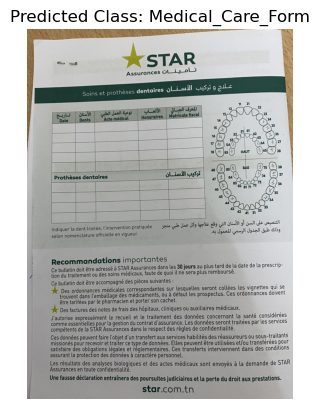

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Image: 437309141_1578982486231687_1166633478136395242_n.png, Predicted Class: Prescriptions, Probability: 0.9703


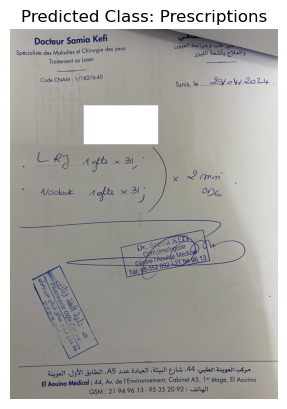

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Image: 437570328_783826817027795_4517083124937635251_n.jpg, Predicted Class: Medical_Care_Form, Probability: 0.0000


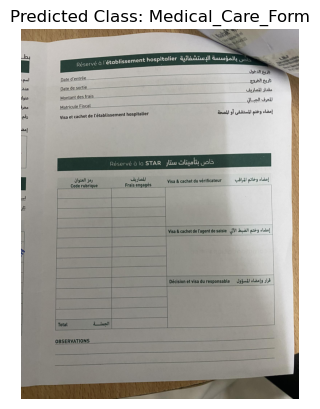

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Image: 437684415_1444024722875900_5023633958174829810_n.png, Predicted Class: Prescriptions, Probability: 0.9795


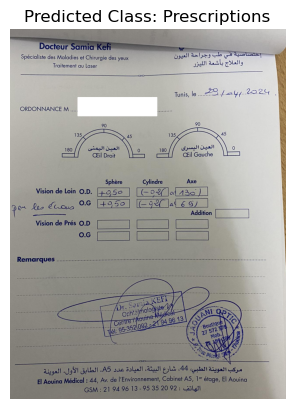

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
Image: 440828430_1484489785470850_257671477554688986_n.png, Predicted Class: Medical_Care_Form, Probability: 0.0000


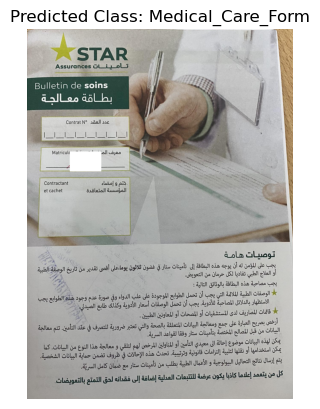

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Image: 67eb8db5-bcea-48b0-809f-e9bc321c98b8.png, Predicted Class: Prescriptions, Probability: 0.9716


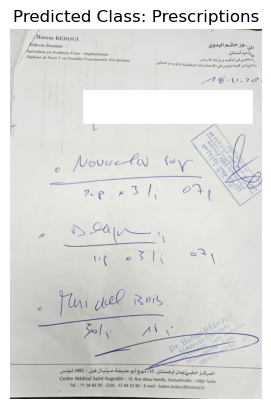

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Image: 6fb4b493-ed73-41b5-be0c-3bbca201cb9b (1).png, Predicted Class: Prescriptions, Probability: 0.9959


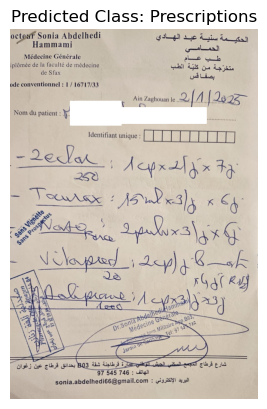

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
Image: 7249eb64-0674-4004-afe5-5bbbb9611404.png, Predicted Class: Medical_Care_Form, Probability: 0.0001


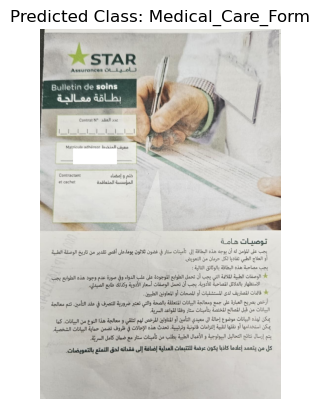

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Image: 7ba84d7c-d722-4350-a66b-98611fa8c03f.png, Predicted Class: Prescriptions, Probability: 0.9780


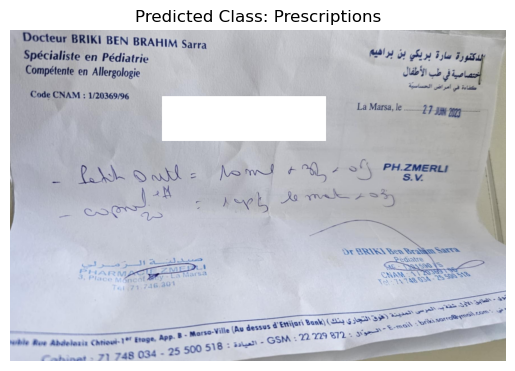

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
Image: 8418f58b-43d9-4d05-961d-f1968c23ef42 (1).png, Predicted Class: Medical_Care_Form, Probability: 0.0000


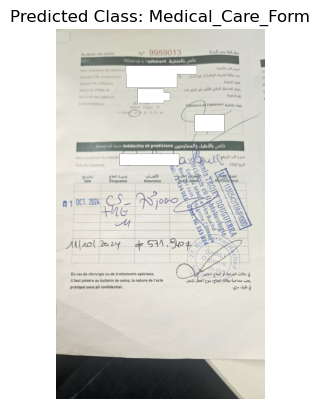

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Image: 84d9e4d1-8a37-49c8-853e-e93f9538deb5.png, Predicted Class: Prescriptions, Probability: 0.9970


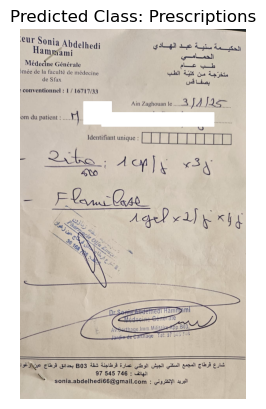

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Image: 936018f5-2453-4256-9575-7f0278615ed4 (1).png, Predicted Class: Prescriptions, Probability: 0.9802


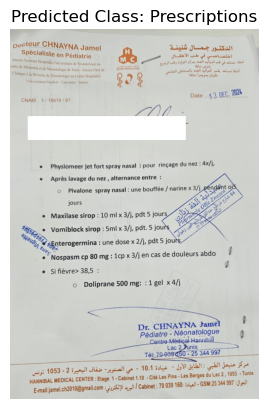

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Image: ayoub.jpeg, Predicted Class: Prescriptions, Probability: 0.9285


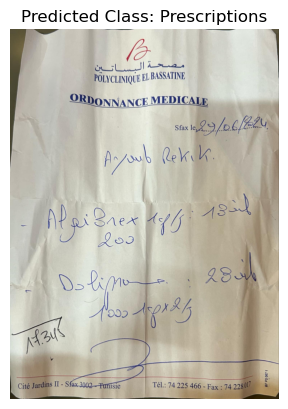

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
Image: BN22257ordonnance-medicale-winou-el-petrole.jpg, Predicted Class: Prescriptions, Probability: 0.9523


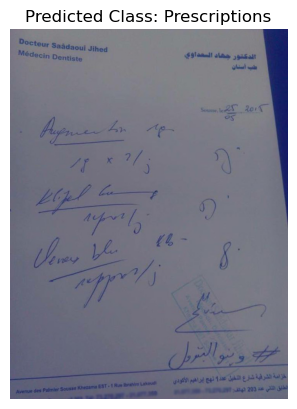

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Image: c9f13968-1910-4b96-9e63-618c3aa37d95.png, Predicted Class: Prescriptions, Probability: 0.9625


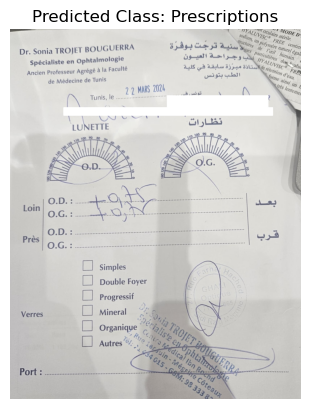

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Image: dbfb91a1-9975-48c3-8f86-bfa4e7fffb0b.png, Predicted Class: Medical_Care_Form, Probability: 0.0000


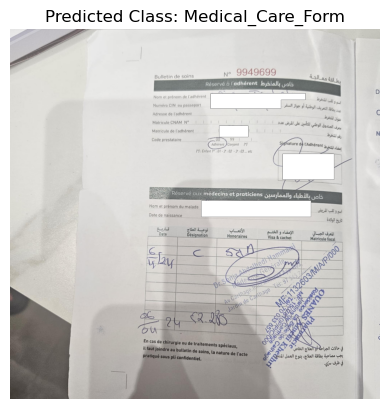

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Image: dc5c1f04-c233-4e68-b42b-2c3216fe7308.png, Predicted Class: Medical_Care_Form, Probability: 0.0000


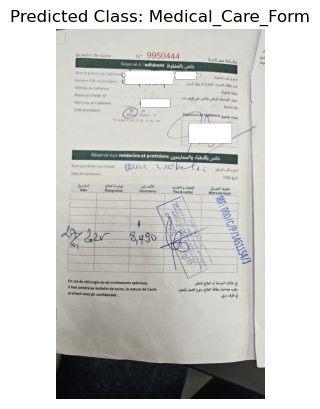

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Image: dfd6ef0f-f8d3-4b07-9775-ed8b9b76f2c3 (1).png, Predicted Class: Medical_Care_Form, Probability: 0.0000


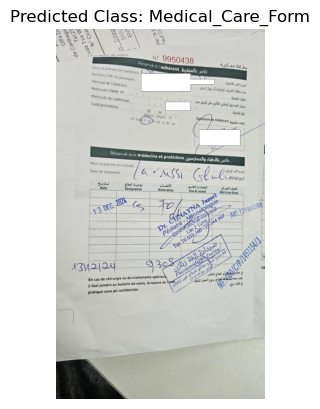

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
Image: e02afbab-3150-42e4-92a6-43b5a960cdb5 (1).png, Predicted Class: Prescriptions, Probability: 0.9827


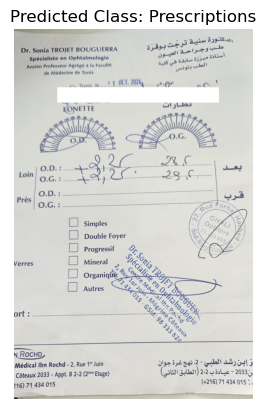

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
Image: e3034721-4b07-44e4-a167-2802acb2c93d.png, Predicted Class: Prescriptions, Probability: 0.9684


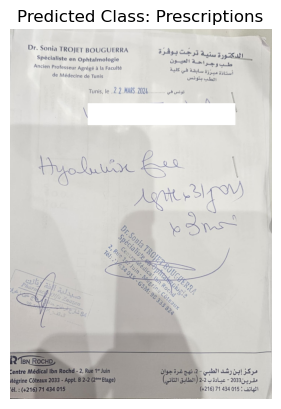

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Image: e6a0230e-1eed-4ca2-8b23-3cd03f48b5c9.png, Predicted Class: Prescriptions, Probability: 0.9671


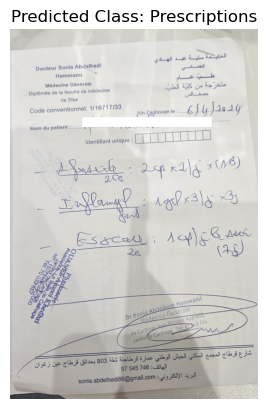

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
Image: ee6e0ce4-c52e-46b8-b381-ad479ecd681b.jpeg, Predicted Class: Medical_Care_Form, Probability: 0.0000


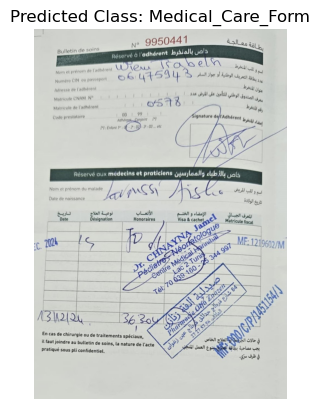

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Image: images (1).jpeg, Predicted Class: Prescriptions, Probability: 0.5685


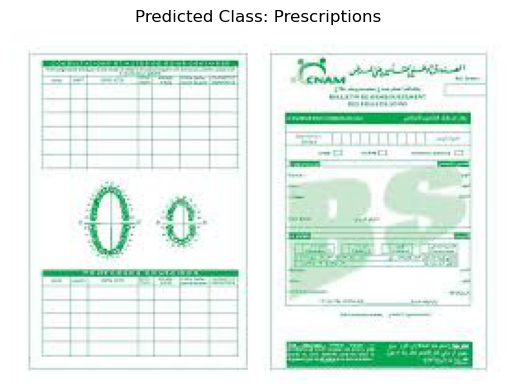

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
Image: images.jpeg, Predicted Class: Medical_Care_Form, Probability: 0.2100


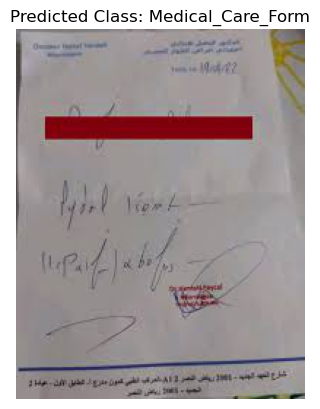

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Image: IMG-20250201-WA0002.jpg, Predicted Class: Medical_Care_Form, Probability: 0.0000


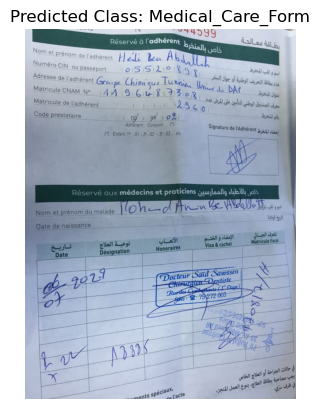

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Image: IMG-20250201-WA0004.jpg, Predicted Class: Prescriptions, Probability: 0.9822


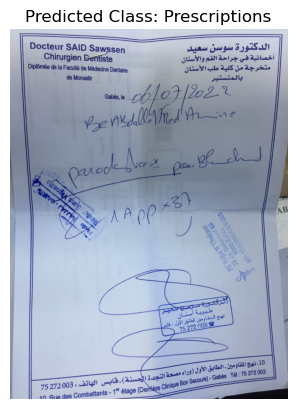

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
Image: IMG-20250201-WA0005.jpg, Predicted Class: Medical_Care_Form, Probability: 0.0000


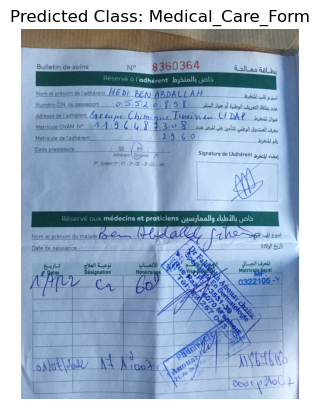

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Image: IMG-20250201-WA0006.jpg, Predicted Class: Prescriptions, Probability: 0.7660


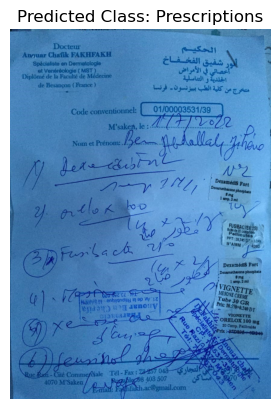

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Image: IMG-20250201-WA0007.jpg, Predicted Class: Medical_Care_Form, Probability: 0.0000


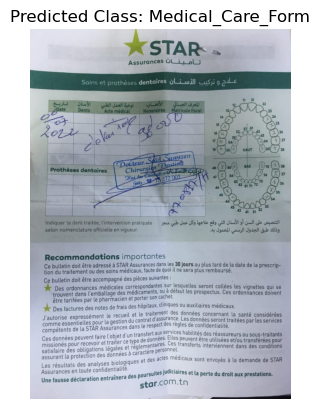

In [31]:
folder_path = "test_images"
predict_images_in_folder(model, folder_path, class_names)

### Step 3: Hyperparameter Tuning 
After evaluating the model's performance, the results indicate that the model is performing exceptionally well across all metrics. 
Therefore, there is no need for hyperparameter tuning at this stage.

# Phase 4: Models Evaluation and Comparison - Pretrained vs. Custom CNN Model
In this phase, we will evaluate and compare the performance of two different models: the pretrained model VGG16 and our custom CNN model. 
By assessing key metrics such as accuracy, precision, recall, F1 score, ROC-AUC, and MSE, we can determine how well each model performs on the same dataset. This comparison will help us understand the strengths and weaknesses of both models, and guide us in selecting the best approach for our task.

In [32]:
import pandas as pd

cnn_vgg_data = {
    "Model": ["Pretrained Model", "CNN Model"],
    "Accuracy": [0.9673, 0.9816],
    "Precision": [0.8797, 0.9355],
    "Recall": [1.0000, 0.9915],
    "F1-Score": [0.9360, 0.9627],
    "ROC AUC": [0.9999, 0.9937],
    "MSE": [0.0327, 0.0184]  
}

df = pd.DataFrame(cnn_vgg_data)

styled_df = df.style.set_table_styles(
    [
        {'selector': 'th', 'props': [('border', '1px solid black'), ('padding', '8px'), ('background-color', '#f2f2f2')]},
        {'selector': 'td', 'props': [('border', '1px solid black'), ('padding', '8px')]},
    ]
).hide(axis='index')

styled_df


Model,Accuracy,Precision,Recall,F1-Score,ROC AUC,MSE
Pretrained Model,0.967300,0.879700,1.000000,0.936000,0.999900,0.032700
CNN Model,0.981600,0.935500,0.991500,0.962700,0.993700,0.018400


## Model Comparison: Custom CNN vs. VGG16  

Both models perform very well, with **VGG16 slightly outperforming** the Custom CNN in validation/test metrics. However, when tested on **new, unseen data**, the **Custom CNN generalizes better** and predicts the outcome more accurately.  

While the performance gap is small, the **Custom CNN is the better choice for deployment**, as it maintains high accuracy.
